### Dynamic College and Labor Supply Model

This model describes an individual’s lifetime decision between **education** and **working**, accounting for **consumption**, **savings** and **human capital accumulation**.

At the initial period \( t = 0 \), the agent chooses whether to attend college or enter the labor market, comparing the expected values of each path. If college is chosen, the agent consumes while incurring education costs and increasing human capital. Upon graduation, the agent enters the labor market, deciding how much to **consume** and **work**, with wages depending on accumulated human capital.

- If **college** is chosen, the agent remains a student for $ t_{\text{college}} = 4 $ years, during which they **consume**, **pay tuition**, and **accumulate human capital**. The psychic cost $ \kappa_X $ is also incurred each year.
- After graduation, at time $t + t_{\text{college}}$, the agent enters the **labor market** with enhanced human capital and starts making labor supply decisions.

- If **work** is chosen directly, the agent starts earning immediately and decides each period how much to **consume** and **work**, while human capital grows on-the-job.

---


#### Initial Decision ($t = 0$)


$$
V_0(X, I) = \max \left\{ \mathbb{E} \left[ V^E\right], \mathbb{E} \left[ V^W \right] \right\}
$$

#### College ($s_t = E$)




$$
V^E _t(E, A_t, k_t, z_t, \epsilon_t) = \max_{c_t} \left\{ \frac{c_t^{1-\rho}}{1-\rho} - \kappa_X + \beta \mathbb{E} \left[ V^W _{t+1}(s_{t+1}, e, A_{t+1}, k_{t+1}\, u_{t+1}) \right] \right\}
$$

$$
A_{t+1} = (1 + r) . A_t - c_t - \text{college cost}
$$

$$
k_{t+1} =
\begin{cases}
k_t + h_t^E & \text{for } t \leq \text{college years} \\
k_t + h_t   & \text{for } t > 4
\end{cases}
$$



#### Labor Market ($s_t = W$)



$$
V^W _t(W, e, A_t, k_t, 0) = \max_{c_t, h_t} \left\{ \frac{c_t^{1-\rho}}{1-\rho} -\varphi \frac{h_t^{1+\eta}}{1+\eta} + \beta \mathbb{E} \left[ V^W _{t+1}(W, e, A_{t+1}, k_{t+1}, u_{t+1}) \right] \right\}
$$

$$
A_{t+1} = (1 + r). A_t + (1 - \tau_{\text{tax}}) w_t h_t - c_t
$$

$$
w_t = w_0(1 + \alpha k_t)
$$

$$
k_{t+1} = k_t + h_t
$$

---

### Model Parameter Settings

| **Parameter**         | **Value**                                         | **Description**                                                     |
|----------------------|---------------------------------------------------|---------------------------------------------------------------------|
| `T`                  | 50                                                | Number of periods (e.g., age 18 to 68)                              |
| `t_college`          | 4                                                 | Duration of college before entering the labor market                |
| `β` (`beta`)         | 0.97                                             | Discount factor (annual)                                            |
| `ρ` (`rho`)          | 1.0                                              | Relative risk aversion (CRRA utility)                               |
| `η` (`eta`)          | 5.0                                               | Inverse Frisch elasticity (elasticity ≈ 2)                          |
| `ϕ` (`phi`)          | 0.003                                              | Weight on disutility of labor                                       |
| `r`                  | 0.03                                              | Real interest rate (annual)                                         |
| `w_0`                | 100,000                                           | Base wage (e.g., starting wage at age 18)                           |
| `α` (`alpha`)        | 0.1                                               | Wage increase per year of human capital (education or experience)   |
| `τ_tax`              | 0.25                                              | Labor income tax rate                                               |
| `κ_X` (`kappa_X`)    | 3,000                                             | Annual psychic cost of attending college                            |
| `college cost`       | 12,000                                            | Annual direct college cost                                          |
| `college boost`      | 2.5                                               | Human capital gain per year of education (1 unit per year)          |
| `a_max`              | 1,000,000                                         | Maximum asset level in grid                                         |
| `Na`                 | 100                                               | Number of grid points for assets                                    |
| `Nk`                 | 50                                                | Number of grid points for human capital                             |
| `k_grid`             | `nonlinspace(0.0, 30.0, Nk, 1.1)`                 | Human capital grid: up to 30 years of experience/schooling          |
| `a_grid`             | `nonlinspace(0.0, a_max, Na, 2.0)`               | Asset grid with finer resolution near zero                          |
| `sim_a_init`         | `rand(rng, simN) .* 100_000`                      | Initial asset distribution: uniformly random up to 100,000          |
| `sim_k_init`         | `zeros(Float64, simN)`                            | Initial human capital: all individuals start with zero              |




---
### Pseudo-Algorithm: College vs. Work Dynamic Model

This algorithm describes the steps for solving and simulating the dynamic model where agents choose between college and work, using value function iteration and policy simulation.


#### **Model Solution (Backward Induction)**

**Input:**  
Parameter set, grids for $a$ (assets) and $k$ (human capital)

##### **A. Work Path Solver**
**Steps:**

1. **Final Period ($t = T$):**
    - For each $(a_T, k_T)$:
        - **Optimize** over labor supply $h_T$:
          - All resources are consumed: $c_T = a_T + \text{wage}_T \cdot h_T + y$
          - Maximize terminal utility $U_T(c_T, h_T)$ with respect to $h_T \in [0,1]$
        - **Store**: optimal $h_T$, $c_T$, and value

2. **Earlier Periods ($t = T-1$ down to $1$):**
    - For each $(a_t, k_t)$:
        - **Interpolate** next-period value $V_{t+1}(a_{t+1}, k_{t+1})$
        - **Optimize** over current consumption $c_t$ and labor $h_t$:
          $$
          \max_{c_t, h_t} \ U_t(c_t, h_t) + \beta V_{t+1}(a_{t+1}, k_{t+1})
          $$
        - **State transitions:**
          - $a_{t+1} = (1 + r)a_t + \text{wage}_t \cdot h_t - c_t + y$
          - $k_{t+1} = k_t + h_t$
        - **Store**: optimal $c_t$, $h_t$, and value



##### **B. College Path Solver**

**Input:**  
- Grids for $a$, $k$, model parameters, and $t_{college}$ (number of periods in college)

**Steps:**
1. **Post-College Periods ($t = t_{college} + 1$ up to $T$):**
    - **Follow the same steps as the Work Path Solver for each $(a_t, k_t)$:**
        - Agents join the workforce after finishing college.
        - Use the same optimization and state transition rules as in the work path.

1. **College Periods ($t = t_{college}$ down to $1$):**
    - For each $(a_t, k_t)$:
        - **Interpolate** next-period value $V_{t+1}(a_{t+1}, k_{t+1})$
        - **Optimize** over $c_t$ (no labor: $h_t = 0$):
          $$
          \max_{c_t} \ U_t^{\text{college}}(c_t) + \beta V_{t+1}(a_{t+1}, k_{t+1})
          $$
        - **State transitions:**
          - $a_{t+1} = (1 + r)a_t - c_t - \text{college\_cost} + y$
          - $k_{t+1} = k_t + \text{college\_boost}$
        - **Store**: optimal $c_t$, $h_t = 0$, and value


**Output:**  
Grids of value and policy functions for college and work, for all $(a_t, k_t)$ and all $t$


---


#### **Simulation**

**Input:**  
Initial states $(a_1^i, k_1^i)$ for $N$ agents

1. **Initial College/Work Choice:**  
    For each agent $i$:
    - Interpolate $V_{college}(a_1^i, k_1^i)$ and $V_{work}(a_1^i, k_1^i)$
    - Set path to whichever value is higher

2. **Simulate Forward:**
    For each agent $i$ and for each period $t = 1, ..., T$:
    - **Policy Application:**
      - Interpolate optimal policies at current $(a_t^i, k_t^i)$ based on agent's chosen path
      - Assign $c_t^i$, $h_t^i$ accordingly (no labor in college periods)
    - **State Transitions:**
      - Update assets and human capital:
        - If in college:  
          - $a_{t+1}^i = (1+r)a_t^i - c_t^i - \text{college\_cost} + y$
          - $k_{t+1}^i = k_t^i + \text{college\_boost}$
        - If in work:  
          - $a_{t+1}^i = (1+r)a_t^i + \text{wage} \times h_t^i - c_t^i + y$
          - $k_{t+1}^i = k_t^i + h_t^i$
      - Apply bounds as needed
    - **Store** all choices and resulting states

3. **Aggregate Results:**  
    - Count and report the number of agents choosing college vs. work
    - Output simulated time paths for $(a_t, c_t, h_t, k_t, \text{income}_t, \text{wage}_t)$ for all agents



### Setup

In [2]:
using Random, NLopt, LinearAlgebra, Interpolations, Base.Threads, DataFrames
using Plots, Statistics, ProgressMeter, ForwardDiff, Distributions, Profile
using DataFrames, Measures, StatsBase, LaTeXStrings, Printf

### Model

In [16]:
# -------------------------------
# Utility: Nonlinear Grid Creator
# -------------------------------
function nonlinspace(start::Float64, stop::Float64, num::Int, curv::Float64)
    lin_vals = range(0, stop=1, length=num)
    curved_vals = lin_vals .^ curv
    return start .+ (stop - start) .* curved_vals
end

function create_focused_grid(a_min::Float64, a_focus::Float64, a_max::Float64, Na::Int, focus_share::Float64, curv::Float64)
    Na_focus = ceil(Int, Na * focus_share)
    Na_rest = Na - Na_focus
    grid_focus = nonlinspace(a_min, a_focus, Na_focus, curv)
    grid_rest = nonlinspace(a_focus, a_max, Na_rest + 1, curv)[2:end]
    return vcat(grid_focus, grid_rest)
end

# =============================================================================
# Dynamic Labor Model Definition with College Decision
#
# This mutable struct defines the model parameters, state grids, solution arrays,
# and simulation arrays for a dynamic consumption-saving model with a college decision.
#
# Key components:
# - Model parameters (e.g., T, beta, r, w, etc.)
# - State variable grids (for assets 'a_grid' and human capital 'k_grid')
# - Solution arrays for both work and college choices (consumption, labor, and value functions)
# - Simulation arrays for consumption, assets, labor, and capital over simulated life paths
# - Other auxiliary arrays, such as initial conditions, random draws, and wage vector (w_vec)
# - Parameters for the college decision (college_cost and college_boost)
# =============================================================================
mutable struct ConSavLaborCollege
    T::Int                     # Total number of periods
    t_college::Int             # Number of college periods
    rho::Float64               # Risk aversion parameter (or relative risk aversion)
    beta::Float64              # Discount factor
    phi::Float64               # Parameter (e.g., disutility of labor or related to college)
    eta::Float64               # Another parameter (e.g., related to preferences)
    alpha::Float64             # Wage increase per year of human capital
    y::Float64                 # Unearned income 
    w::Float64                 # Base wage level
    tau::Float64               # Tax rate or other scaling parameter on wage income
    r::Float64                 # Interest rate on assets
    a_max::Float64             # Maximum asset level in the grid
    a_min::Float64             # Minimum asset level (borrowing constraint)
    Na::Int                    # Number of grid points for assets
    k_max::Float64             # Maximum human capital level in the grid
    Nk::Int                    # Number of grid points for human capital
    simT::Int                  # Number of simulation periods (typically equals T)
    simN::Int                  # Number of simulation agents
    a_grid::Vector{Float64}    # Grid for assets (state variable)
    k_grid::Vector{Float64}    # Grid for human capital (state variable)

    # Solution arrays for the working alternative
    sol_c_work::Array{Float64, 3}  # Optimal consumption when working
    sol_h_work::Array{Float64, 3}  # Optimal labor supply when working
    sol_v_work::Array{Float64, 3}  # Value function when working

    # Solution arrays for the college alternative
    sol_c_college::Array{Float64, 3}  # Optimal consumption when in college
    sol_h_college::Array{Float64, 3}  # Optimal labor supply when in college (typically zero)
    sol_v_college::Array{Float64, 3}  # Value function when in college

    # Simulation arrays (each row corresponds to one simulated agent over time)
    sim_c::Matrix{Float64}      # Consumption over time
    sim_h::Matrix{Float64}      # Labor supply over time
    sim_a::Matrix{Float64}      # Asset holdings over time
    sim_k::Matrix{Float64}      # Human capital over time
    sim_a_init::Vector{Float64} # Initial asset levels for simulated agents
    sim_k_init::Vector{Float64} # Initial human capital for simulated agents
    sim_income::Matrix{Float64}  # Income over time (not explicitly defined in the original code)
    sim_wage::Matrix{Float64}  # Wage over time (not explicitly defined in the original code)
    
    draws_uniform::Matrix{Float64}  # Matrix of uniform random draws for simulation purposes
    w_vec::Vector{Float64}          # Wage vector over time (can vary across periods)
    college_cost::Float64           # Cost of attending college per period (or overall cost structure)
    college_boost::Float64          # Increase in human capital (or productivity boost) from college
    college_boost_belief::Float64   # Biased belief
end

# =============================================================================
# Constructor for ConSavLaborCollege
#
# This constructor initializes the model with default parameters or user-specified ones.
# It sets up:
# - The time horizon (T) and the number of college periods (t_college)
# - The asset and human capital grids using the nonlinspace utility function
# - Empty solution arrays (filled with NaN) for both work and college alternatives
# - Simulation arrays with appropriate dimensions, including initial conditions
# - The wage vector (w_vec) and random draws for simulation purposes
# - The parameters specific to the college decision (college_cost and college_boost)
# =============================================================================
function ConSavLaborCollege(; 
    T::Int=50, t_college::Int=4, beta::Float64=0.97, rho::Float64=1.0, 
    r::Float64=0.03, a_max::Float64=200000.0, Na::Int=50, y::Float64=5000.0,
    simN::Int=5000, a_min::Float64=0.0, k_max::Float64=50.0, Nk::Int=50, 
    w::Float64=12.5, tau::Float64=0.25, eta::Float64=2.0, alpha::Float64=0.1, 
    phi::Float64=20.0, seed::Int=1234, college_cost::Float64=12000.0, 
    college_boost::Float64=2.0, college_boost_belief::Float64=10.0)
    
    simT = T  # Simulation time equals model time horizon
    
    # --- Grids for state variables ---
    #a_grid = create_focused_grid(a_min, 500000.0, a_max, Na, 0.5, 1.1);    # Nonlinear grid for assets
    a_grid = create_focused_grid(a_min, 50000.0, a_max, Na, 0.8, 1.1)
    k_grid = nonlinspace(0.0, k_max, Nk, 1.5)      # Nonlinear grid for human capital

    # --- Initialize solution arrays (3D arrays for each period, asset, and human capital grid point) ---
    sol_c_work = fill(NaN, (T, Na, Nk));
    sol_h_work = fill(NaN, (T, Na, Nk));
    sol_v_work = fill(NaN, (T, Na, Nk));

    sol_c_college = fill(NaN, (T, Na, Nk));
    sol_h_college = fill(NaN, (T, Na, Nk));
    sol_v_college = fill(NaN, (T, Na, Nk));

    # --- Initialize simulation arrays (rows: simulated agents, columns: periods) ---
    sim_c = fill(NaN, (simN, T));
    sim_h = fill(NaN, (simN, T));
    sim_a = fill(NaN, (simN, T));
    sim_k = fill(NaN, (simN, T));

    # --- Set initial conditions for simulation ---
    rng = MersenneTwister(seed);
    sim_a_init = rand(rng, simN) .* 100000;  # Initial assets drawn from a uniform distribution
    sim_k_init = zeros(Float64, simN);         # Initial human capital is set to zero
    sim_income = fill(NaN, (simN, T));  # Initialize income array for simulation
    sim_wage = fill(NaN, (simN, T));   # Initialize wage array for simulation

    # --- Initialize wage vector and random draws for simulation ---
    w_vec = fill(w, T);                        # Wage remains constant over time by default
    draws_uniform = rand(rng, simN, T);          # Uniform random draws for simulation purposes
    
    # --- Return an instance of ConSavLaborCollege with all fields initialized ---
    return ConSavLaborCollege(
        T, t_college, rho, beta, phi, eta, alpha, y, w, tau, r,
        a_max, a_min, Na, k_max, Nk, simT, simN, a_grid, k_grid,
        sol_c_work, sol_h_work, sol_v_work, sol_c_college, sol_h_college, sol_v_college,
        sim_c, sim_h, sim_a, sim_k,
        sim_a_init, sim_k_init, sim_income, sim_wage,
        draws_uniform, w_vec, college_cost, college_boost, college_boost_belief
    )
end

ConSavLaborCollege

In [17]:
# --------------------------
# Model Solver for College Periods
# --------------------------
function solve_model_college!(model::ConSavLaborCollege)
    T, Na, Nk = model.T, model.Na, model.Nk
    a_grid, k_grid = model.a_grid, model.k_grid
    sol_c, sol_h, sol_v = model.sol_c_college, model.sol_h_college, model.sol_v_college

    # --- Final period (t = T) ---
    # For each asset and capital grid point, choose optimal hours that maximize utility.
    for i_a in 1:Na
        for i_k in 1:Nk
            assets = a_grid[i_a]
            capital = k_grid[i_k]
            # Objective: minimize the negative utility at terminal period.
            function obj_last(h_vec::Vector, grad::Vector)
                return obj_last_period(model, h_vec[1], assets, capital, T)
            end
            # Use LN_COBYLA (derivative-free) to optimize over hours (constrained between 0 and 1)
            opt = Opt(:LN_COBYLA, 1)
            lower_bounds!(opt, [0.0])
            upper_bounds!(opt, [1.0])
            ftol_rel!(opt, 1e-8)
            min_objective!(opt, obj_last)
            init = [0.5]  # Initial guess for hours
            (minf, h_vec, ret) = optimize(opt, init)
            h_opt = h_vec[1]
            cons = assets + wage_func(model, capital, T) * h_opt
            sol_h[T, i_a, i_k] = h_opt
            sol_c[T, i_a, i_k] = cons
            sol_v[T, i_a, i_k] = -minf  # Utility is negative of the minimized objective
        end
    end

    # --- Work Periods (t = T-1 to t_college + 1) ---
    # Solve for consumption and hours when agents are working.
    @showprogress 1 "Solving college periods..." for t in (T-1):-1:(model.t_college + 1)
        interp = create_interp(model, sol_v, t+1)  # Interpolate the value function at next period
        for i_a in 1:Na
            for i_k in 1:Nk
                assets = a_grid[i_a]
                capital = k_grid[i_k]
                # Objective: maximize utility from working by optimizing consumption and labor.
                function obj_work(x_vec::Vector, grad::Vector)
                    return -value_of_work_choice(model, x_vec[1], x_vec[2], assets, capital, t, interp)
                end
                # Optimize over two variables: consumption and hours (h in [0,1])
                opt = Opt(:LN_COBYLA, 2)
                lower_bounds!(opt, [1e-6, 0.0])
                upper_bounds!(opt, [Inf, 1.0])
                ftol_rel!(opt, 1e-8)
                min_objective!(opt, obj_work)
                init = [sol_c[t+1, i_a, i_k], sol_h[t+1, i_a, i_k]]
                (minf, x_opt, ret) = optimize(opt, init)
                sol_c[t, i_a, i_k] = x_opt[1]
                sol_h[t, i_a, i_k] = x_opt[2]
                sol_v[t, i_a, i_k] = -minf
            end
        end
    end

    # --- College Periods (t = t_college to 1) ---
    # In college, no labor is supplied; only consumption is optimized.
    for t in model.t_college:-1:1
        interp = create_interp(model, sol_v, t+1)
        for i_a in 1:Na
            for i_k in 1:Nk
                assets = a_grid[i_a]
                capital = k_grid[i_k]
                function obj_college(c_vec::Vector, grad::Vector)
                    return -value_of_college_choice(model, c_vec[1], assets, capital, t, interp)
                end
                opt = Opt(:LN_COBYLA, 1)
                lower_bounds!(opt, [1e-6])
                upper_bounds!(opt, [Inf])
                ftol_rel!(opt, 1e-8)
                min_objective!(opt, obj_college)
                init = [max(sol_c[t+1, i_a, i_k], 1e-6)]
                (minf, c_vec_opt, ret) = optimize(opt, init)
                sol_c[t, i_a, i_k] = c_vec_opt[1]
                sol_h[t, i_a, i_k] = 0.0  # No work during college
                sol_v[t, i_a, i_k] = -minf
            end
        end
    end 

    return model
end

# --------------------------
# Model Solver for Work Periods
# --------------------------
function solve_model_work!(model::ConSavLaborCollege)
    T, Na, Nk = model.T, model.Na, model.Nk
    a_grid, k_grid = model.a_grid, model.k_grid
    sol_c, sol_h, sol_v = model.sol_c_work, model.sol_h_work, model.sol_v_work

    # --- Final period (t = T) ---
    for i_a in 1:Na
        for i_k in 1:Nk
            assets = a_grid[i_a]
            capital = k_grid[i_k]
            function obj_last(h_vec::Vector, grad::Vector)
                return obj_last_period(model, h_vec[1], assets, capital, T)
            end
            opt = Opt(:LN_COBYLA, 1)
            lower_bounds!(opt, [0.0])
            upper_bounds!(opt, [1.0])
            ftol_rel!(opt, 1e-8)
            min_objective!(opt, obj_last)
            init = [0.5]
            (minf, h_vec, ret) = optimize(opt, init)
            h_opt = h_vec[1]
            cons = assets + wage_func(model, capital, T) * h_opt
            sol_h[T, i_a, i_k] = h_opt
            sol_c[T, i_a, i_k] = cons
            sol_v[T, i_a, i_k] = -minf
        end
    end

    # --- Earlier periods (t = T-1 to 1) ---
    @showprogress 1 "Solving working model..." for t in (T-1):-1:1
        interp = create_interp(model, sol_v, t + 1)
        for i_a in 1:Na
            for i_k in 1:Nk
                assets = a_grid[i_a]
                capital = k_grid[i_k]
                function obj_work(x_vec::Vector, grad::Vector)
                    return -value_of_work_choice(model, x_vec[1], x_vec[2], assets, capital, t, interp)
                end
                opt = Opt(:LN_COBYLA, 2)  # Optimize over consumption and labor
                lower_bounds!(opt, [1e-6, 0.0])
                upper_bounds!(opt, [Inf, 1.0])
                ftol_rel!(opt, 1e-8)
                min_objective!(opt, obj_work)
                init = [sol_c[t + 1, i_a, i_k], sol_h[t + 1, i_a, i_k]]
                (minf, x_opt, ret) = optimize(opt, init)
                sol_c[t, i_a, i_k] = x_opt[1]  # Optimal consumption
                sol_h[t, i_a, i_k] = x_opt[2]  # Optimal labor
                sol_v[t, i_a, i_k] = -minf     # Value function
            end
        end
    end

    return model
end

# ------------------------------------------------
# Supporting functions 
# ------------------------------------------------
@inline function util_work(model::ConSavLaborCollege, c, h)
    if model.rho == 1.0
        cons_utility = log(c)
    else
        cons_utility = (c^(1.0 - model.rho)) / (1.0 - model.rho)
    end
    labor_disutility = model.phi * (h^(1.0 + model.eta)) / (1.0 + model.eta)
    return cons_utility - labor_disutility
end

# Utility function for college periods with No labor disutility
@inline function util_college(model::ConSavLaborCollege, c::Float64)
    return log(c) # - pychic cost
end

# Wage function
@inline function wage_func(model::ConSavLaborCollege, k::Float64, t::Int)
    return (1.0 - model.tau) * model.w_vec[t] * (1.0 + model.alpha * k) * 5840
end

# Objective function for the last period
function obj_last_period(model::ConSavLaborCollege, h::Float64, assets::Float64, capital::Float64, t::Int)
    income = wage_func(model, capital, t) * h
    cons = assets + income + model.y # Consume all resources
    u = util_work(model, cons, h)
    return -u  # Minimize negative utility
end

# Value of college choice
function value_of_college_choice(model::ConSavLaborCollege, c::Float64, assets::Float64,
    capital::Float64, t::Int, interp)
    # Current penalty for negative consumption
    penalty_c = c < 0.0 ? (abs(c)^2) * 1.0e6 : 0.0
    # Compute next period's assets
    a_next = (1.0 + model.r) * assets - c - model.college_cost + model.y
    # Penalty for assets below a_min
    penalty_a = a_next < model.a_min ? (model.a_min - a_next) * 1.0e6 : 0.0
    # Utility and continuation value
    util_now = util_college(model, c)
    k_next = capital + model.college_boost
    V_next = interp(a_next, k_next)
    return util_now + model.beta * V_next - penalty_c - penalty_a
end

# Value of work choice
function value_of_work_choice(model::ConSavLaborCollege, c::Float64, h::Float64, assets::Float64,
    capital::Float64, t::Int, interp)
    # Current penalties for negative consumption and hours
    penalty_c = c < 0.0 ? (abs(c)^2) * 1.0e7 : 0.0
    penalty_h = h < 0.0 ? (abs(h)^2) * 10e8 : 0.0
    # Compute next period's assets
    income = wage_func(model, capital, t) * h
    a_next = (1.0 + model.r) * assets + income - c + model.y
    # Penalty for assets below a_min
    penalty_a = a_next < model.a_min ? (model.a_min - a_next) * 1.0e14 : 0.0
    # Utility and continuation value
    util_now = util_work(model, c, h)
    k_next = capital + h
    V_next = interp(a_next, k_next)
    return util_now + model.beta * V_next - penalty_c - penalty_h - penalty_a
end
# Interpolation helper function
function create_interp(model::ConSavLaborCollege, sol_v::Array{Float64, 3}, t::Int)
    return LinearInterpolation((model.a_grid, model.k_grid), sol_v[t, :, :], extrapolation_bc=Line())
end

# --------------------------
# Simulation
# --------------------------
# Simulate consumption and asset paths based on the solved policy functions

function simulate_model!(model::ConSavLaborCollege)
    # ------------------------------------------------
    # 1) Basic setup and parameter extraction
    # ------------------------------------------------
    simN, T         = model.simN, model.T
    a_max, k_max    = model.a_max, model.k_max
    t_college       = model.t_college
    r               = model.r
    college_cost    = model.college_cost
    college_boost   = model.college_boost
    a_min           = model.a_min
    sim_c, sim_h    = model.sim_c, model.sim_h
    sim_a, sim_k    = model.sim_a, model.sim_k
    sim_a_init      = model.sim_a_init
    sim_k_init      = model.sim_k_init
    sim_income      = model.sim_income
    sim_wage        = model.sim_wage  # Assumes preallocated array

    # ------------------------------------------------
    # 2) Initial conditions
    # ------------------------------------------------
    a0_vec = sim_a_init
    k0_vec = sim_k_init

    # ------------------------------------------------
    # 3) Compute initial values & choose college vs. work
    # ------------------------------------------------
    interp_v_college = LinearInterpolation((model.a_grid, model.k_grid),
                                        model.sol_v_college[1, :, :],
                                        extrapolation_bc=Line())
    interp_v_work = LinearInterpolation((model.a_grid, model.k_grid),
                                        model.sol_v_work[1, :, :],
                                        extrapolation_bc=Line())

    path_choice = Vector{Symbol}(undef, simN)

    for i in 1:simN
        V_college = interp_v_college(a0_vec[i], k0_vec[i])
        V_work    = interp_v_work(a0_vec[i], k0_vec[i])
        path_choice[i] = V_college > V_work ? :college : :work
    end

    # ------------------------------------------------
    # 4) Precompute policy-function interpolators
    # ------------------------------------------------
    interp_c_college = [
        LinearInterpolation((model.a_grid, model.k_grid),
                            model.sol_c_college[t, :, :],
                            extrapolation_bc=Line()) for t in 1:T
    ]
    interp_h_college = [
        LinearInterpolation((model.a_grid, model.k_grid),
                            model.sol_h_college[t, :, :],
                            extrapolation_bc=Line()) for t in 1:T
    ]
    interp_c_work = [
        LinearInterpolation((model.a_grid, model.k_grid),
                            model.sol_c_work[t, :, :],
                            extrapolation_bc=Line()) for t in 1:T
    ]
    interp_h_work = [
        LinearInterpolation((model.a_grid, model.k_grid),
                            model.sol_h_work[t, :, :],
                            extrapolation_bc=Line()) for t in 1:T
    ]

    # ------------------------------------------------
    # 5) Initialize the simulation arrays
    # ------------------------------------------------
    sim_a[:, 1] = a0_vec
    sim_k[:, 1] = k0_vec

    # ------------------------------------------------
    # 6) Simulate forward for each t = 1,...,T
    # ------------------------------------------------
    for t in 1:T
        for i in 1:simN
            # Retrieve current states
            a = sim_a[i, t]
            k = sim_k[i, t]

            # Choose consumption & hours via policy
            if path_choice[i] == :college
                c = interp_c_college[t](a, k)
                h = interp_h_college[t](a, k)
            else
                c = interp_c_work[t](a, k)
                h = interp_h_work[t](a, k)
            end

            sim_c[i, t] = c
            sim_h[i, t] = h

            # Compute income and wage based on path and time
            if path_choice[i] == :college && t <= t_college
                sim_income[i, t] = 0 # No income during college
                sim_wage[i, t] = 0    # No wage during college
            else
                wage = wage_func(model, k, t)
                sim_income[i, t] = wage * h 
                sim_wage[i, t] = wage / 5840
            end

            # If not in the final period, update next period's states
            if t < T
                if path_choice[i] == :college
                    if t <= t_college
                        a_next = (1 + r)*a - c - college_cost + model.y
                        k_next = k + college_boost
                    else
                        a_next = (1 + r)*a + sim_income[i, t] - c + model.y
                        k_next = k + h
                    end
                else
                    a_next = (1 + r)*a + sim_income[i, t] - c + model.y
                    k_next = k + h
                end

                a_next = max(a_next, a_min)
                sim_a[i, t+1] = a_next
                sim_k[i, t+1] = k_next
            end
        end
    end

    # ------------------------------------------------
    # 7) Store final results, print aggregates
    # ------------------------------------------------
    model.sim_a = sim_a
    model.sim_c = sim_c
    model.sim_h = sim_h
    model.sim_k = sim_k
    model.sim_income = sim_income
    model.sim_wage = sim_wage

    num_college = sum(path_choice .== :college)
    num_work    = sum(path_choice .== :work)

    println("Number choosing college: $num_college")
    println("Number choosing work:    $num_work")

    return model, path_choice
end

simulate_model! (generic function with 1 method)

### Model and Counterfactual Simulation in a T-Period 
This script solves and simulates a finite-horizon (T-period) consumption-saving model under different economic scenarios. It compares a baseline model with 8 counterfactual experiments, focusing on how each setting affects average consumption and asset accumulation over time.

In [36]:
# --------------------------
# Baseline Model
# --------------------------
println("\n---------------------------------------")
println("Baseline Model")
model_baseline = ConSavLaborCollege();
solve_model_college!(model_baseline);
solve_model_work!(model_baseline);
model_baseline, path_choice_baseline = simulate_model!(model_baseline);
h_avg = mean(model_baseline.sim_h)

# --------------------------
# Counterfactual 1: Higher College Cost
# --------------------------
# In this scenario, the college cost is raised (e.g., to 15000.0) to reflect higher tuition.
println("\n---------------------------------------")
println("Counterfactual 1: Higher College Cost (college_cost = 15000.0)")
model_cf1 = ConSavLaborCollege(college_cost=15000.0);
solve_model_college!(model_cf1);
solve_model_work!(model_cf1);
model_cf1, path_choice_cf1 = simulate_model!(model_cf1);

# --------------------------
# Counterfactual 2: Lower College Cost
# --------------------------
# Here, the college cost is decreased (to 500.0) so that college becomes more affordable.
println("\n---------------------------------------")
println("Counterfactual 2: Lower College Cost (college_cost = 5000.0)")
model_cf2 = ConSavLaborCollege(college_cost=5000.0);
solve_model_college!(model_cf2);
solve_model_work!(model_cf2);
model_cf2, path_choice_cf2 = simulate_model!(model_cf2);

# --------------------------
# Counterfactual 3: Higher College Boost
# --------------------------
# In this scenario, the benefit from attending college (college_boost) is increased to 10.0.
println("\n---------------------------------------")
println("Counterfactual 3: Higher College Boost (college_boost = 10.0)")
model_cf3 = ConSavLaborCollege(college_boost=10.0);
solve_model_college!(model_cf3);
solve_model_work!(model_cf3);
model_cf3, path_choice_cf3 = simulate_model!(model_cf3);

# --------------------------
# Counterfactual 4: Lower College Boost
# --------------------------
# The boost is reduced (college_boost set to 1.5), which might discourage college attendance.
println("\n---------------------------------------")
println("Counterfactual 4: Lower College Boost (college_boost = 1.5)")
model_cf4 = ConSavLaborCollege(college_boost=1.5);
solve_model_college!(model_cf4);
solve_model_work!(model_cf4);
model_cf4, path_choice_cf4 = simulate_model!(model_cf4);

# --------------------------
# Counterfactual 5: Higher Interest Rate
# --------------------------
# The interest rate is increased (r = 0.05), affecting both borrowing costs and the returns on savings.
println("\n---------------------------------------")
println("Counterfactual 5: Higher Interest Rate (r = 0.05)")
model_cf5 = ConSavLaborCollege(r=0.05);
solve_model_college!(model_cf5);
solve_model_work!(model_cf5);
model_cf5, path_choice_cf5 = simulate_model!(model_cf5);

# --------------------------
# Counterfactual 6: Lower Interest Rate
# --------------------------
# In this case, the interest rate is lowered (r = 0.01), which can alter financing conditions.
println("\n---------------------------------------")
println("Counterfactual 6: Lower Interest Rate (r = 0.01)")
model_cf6 = ConSavLaborCollege(r=0.01);
solve_model_college!(model_cf6);
solve_model_work!(model_cf6);
model_cf6, path_choice_cf6 = simulate_model!(model_cf6);

# --------------------------
# Counterfactual 7: Lower Wage Increase per Year of Human Capital
# --------------------------
# Here, alpha is lowered (alpha = 0.05), implying a smaller wage gain from additional education.
println("\n---------------------------------------")
println("Counterfactual 7: Lower Wage Increase per Year of Human Capital (alpha = 0.05)")
model_cf7 = ConSavLaborCollege(alpha=0.05);
solve_model_college!(model_cf7);
solve_model_work!(model_cf7);
model_cf7, path_choice_cf7 = simulate_model!(model_cf7);

# --------------------------
# Counterfactual 8: Higher Wage Increase per Year of Human Capital
# --------------------------
# In this scenario, alpha is raised (alpha = 0.5) to reflect higher productivity from more human capital.
println("\n---------------------------------------")
println("Counterfactual 8: Higher Wage Increase per Year of Human Capital (alpha = 0.5)")
model_cf8 = ConSavLaborCollege(alpha=0.5);
solve_model_college!(model_cf8);
solve_model_work!(model_cf8);
model_cf8, path_choice_cf8 = simulate_model!(model_cf8);

# --------------------------
# Counterfactual 9: Utility from Leisure
# --------------------------
# Here, the utility parameter from leisure (eta) is increased (eta = 7.0).
println("\n---------------------------------------")
println("Counterfactual 9: Lower utility from Leisure (eta = 5.0)")
model_cf9 = ConSavLaborCollege(eta=5.0);
solve_model_college!(model_cf9);
solve_model_work!(model_cf9);
model_cf9, path_choice_cf9 = simulate_model!(model_cf9);

# --------------------------
# Counterfactual 10: Higher Discount Factor
# --------------------------
# In this case, the discount factor is increased (beta = 0.99), which can affect intertemporal decisions.
println("\n---------------------------------------")
println("Counterfactual 10: Higher Discount Factor (beta = 0.99)")
model_cf10 = ConSavLaborCollege(beta=0.99);
solve_model_college!(model_cf10);
solve_model_work!(model_cf10);
model_cf10, path_choice_cf10 = simulate_model!(model_cf10);

# --------------------------
# Counterfactual 11: Lower Discount Factor
# --------------------------
# Finally, the discount factor is lowered (beta = 0.96), changing the trade-off between present and future consumption.
println("\n---------------------------------------")
println("Counterfactual 11: Lower Discount Factor (beta = 0.90)")
model_cf11 = ConSavLaborCollege(beta=0.96);
solve_model_college!(model_cf11);
solve_model_work!(model_cf11);
model_cf11, path_choice_cf11 = simulate_model!(model_cf11);


---------------------------------------
Baseline Model


Solving college periods... 100%|█████████████████████████| Time: 0:00:01
Solving working model... 100%|███████████████████████████| Time: 0:00:01


Number choosing college: 2741
Number choosing work:    2259

---------------------------------------
Counterfactual 1: Higher College Cost (college_cost = 15000.0)


Solving working model... 100%|███████████████████████████| Time: 0:00:01


Number choosing college: 2041
Number choosing work:    2959

---------------------------------------
Counterfactual 2: Lower College Cost (college_cost = 5000.0)


Solving working model... 100%|███████████████████████████| Time: 0:00:01


Number choosing college: 4247
Number choosing work:    753

---------------------------------------
Counterfactual 3: Higher College Boost (college_boost = 10.0)


Solving working model... 100%|███████████████████████████| Time: 0:00:01


Number choosing college: 3616
Number choosing work:    1384

---------------------------------------
Counterfactual 4: Lower College Boost (college_boost = 1.5)


Solving college periods... 100%|█████████████████████████| Time: 0:00:01
Solving working model... 100%|███████████████████████████| Time: 0:00:01


Number choosing college: 1976
Number choosing work:    3024

---------------------------------------
Counterfactual 5: Higher Interest Rate (r = 0.05)


Solving working model... 100%|███████████████████████████| Time: 0:00:01


Number choosing college: 2826
Number choosing work:    2174

---------------------------------------
Counterfactual 6: Lower Interest Rate (r = 0.01)


Solving college periods... 100%|█████████████████████████| Time: 0:00:01
Solving working model... 100%|███████████████████████████| Time: 0:00:01


Number choosing college: 2631
Number choosing work:    2369

---------------------------------------
Counterfactual 7: Lower Wage Increase per Year of Human Capital (alpha = 0.05)


Solving working model... 100%|███████████████████████████| Time: 0:00:01


Number choosing college: 1460
Number choosing work:    3540

---------------------------------------
Counterfactual 8: Higher Wage Increase per Year of Human Capital (alpha = 0.5)


Solving college periods... 100%|█████████████████████████| Time: 0:00:01
Solving working model... 100%|███████████████████████████| Time: 0:00:01


Number choosing college: 3447
Number choosing work:    1553

---------------------------------------
Counterfactual 9: Lower utility from Leisure (eta = 5.0)


Solving working model... 100%|███████████████████████████| Time: 0:00:01


Number choosing college: 807
Number choosing work:    4193

---------------------------------------
Counterfactual 10: Higher Discount Factor (beta = 0.99)


Solving college periods... 100%|█████████████████████████| Time: 0:00:01
Solving working model... 100%|███████████████████████████| Time: 0:00:01


Number choosing college: 3284
Number choosing work:    1716

---------------------------------------
Counterfactual 11: Lower Discount Factor (beta = 0.90)


Solving working model... 100%|███████████████████████████| Time: 0:00:01


Number choosing college: 2331
Number choosing work:    2669


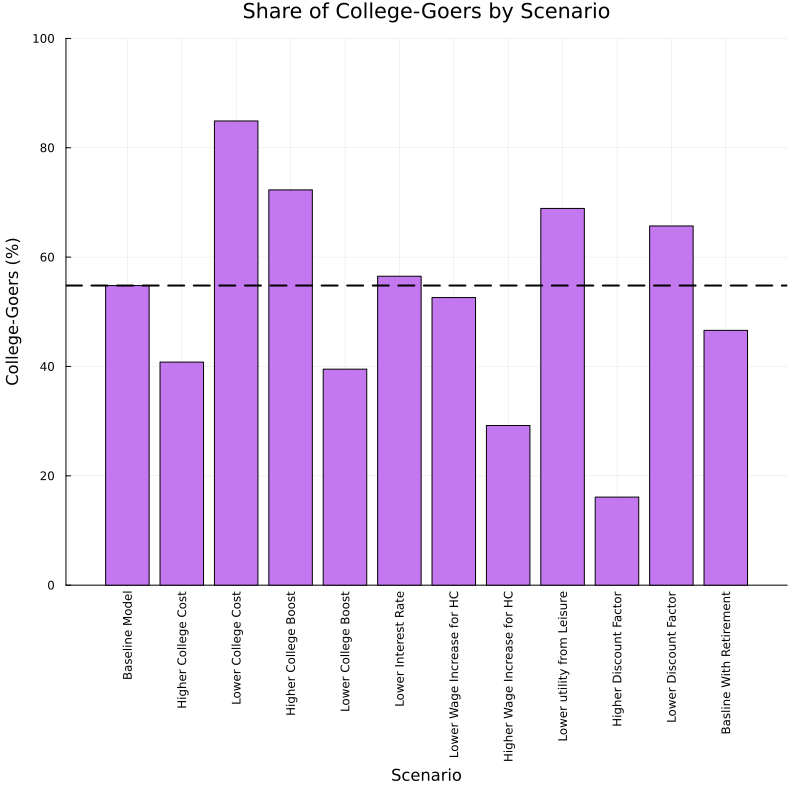

In [8]:

# 1) Define scenario labels and recorded results with updated numbers
scenarios = [
    "Baseline Model",
    "Higher College Cost",
    "Lower College Cost",
    "Higher College Boost",
    "Lower College Boost",
    "Lower Interest Rate",
    "Lower Wage Increase for HC",
    "Higher Wage Increase for HC",
    "Lower utility from Leisure",
    "Higher Discount Factor",
    "Lower Discount Factor",
    "Basline With Retirement"
];

# Number choosing college and work, respectively (updated)
num_college = [2741, 2041, 4247, 3616, 1976, 2826, 2631, 1460, 3447, 807, 3284, 2331];
num_work    = [2259, 2959, 753, 1384, 3024, 2174, 2369, 3540, 1553, 4193, 1716, 2669];

# 2) Compute the fraction who choose college (percentage)
p_college = [num_college[i] / (num_college[i] + num_work[i]) for i in 1:length(scenarios)];
p_college_percent = p_college .* 100;

# 3) Create a DataFrame (round percentages for readability)
df = DataFrame(
    Scenario   = scenarios,
    College    = num_college,
    Work       = num_work,
    CollegePct = round.(p_college_percent, digits=1)
);

# Optionally, display the table
# display(df);
baseline_val = df.CollegePct[1]
#baseline_val = df[df.Scenario .== "Baseline Model", :CollegePct][1]
# 5) Bar chart of the percentage who attend college, with vertical x-axis labels and pastel colors.
plt = bar(
    df.Scenario,
    df.CollegePct,
    xlabel    = "Scenario",
    ylabel    = "College-Goers (%)",
    title     = "Share of College-Goers by Scenario",
    ylims     = (0, 100),
    xrotation = 90,
    size      = (800, 800),
    legend    = false,
    palette   = :pastel
)

hline!([baseline_val], linestyle=:dash, color=:black, linewidth=2, label="Baseline")
display(plt)



### Model Structure and Policy Function Visualization

- **Asset Grid (Top-left):**  
  Displays the nonlinear asset grid, with denser points at low asset levels.

- **Terminal Value Function (Top-right):**  
Depicts the value function at \(T = 50\), representing lifetime utility as a function of assets.

- **Terminal Consumption Policy (Middle-left):**  
  Shows optimal consumption at the terminal period (\(T = 50\)), where agents consume all available resources.

- **Early Consumption Policy (Middle-right):**  
  Illustrates optimal consumption at an earlier period (\(T = 10\)), reflecting saving behavior.

- **Early Labor Policy (Bottom-left):**  
  Displays optimal labor supply at \(T = 10\).

- **Terminal Labor Policy (Bottom-right):**  
  Shows optimal labor supply at \(T = 50\).

This layout clarifies how the asset grid design and time dynamics shape optimal consumption and labor decisions.

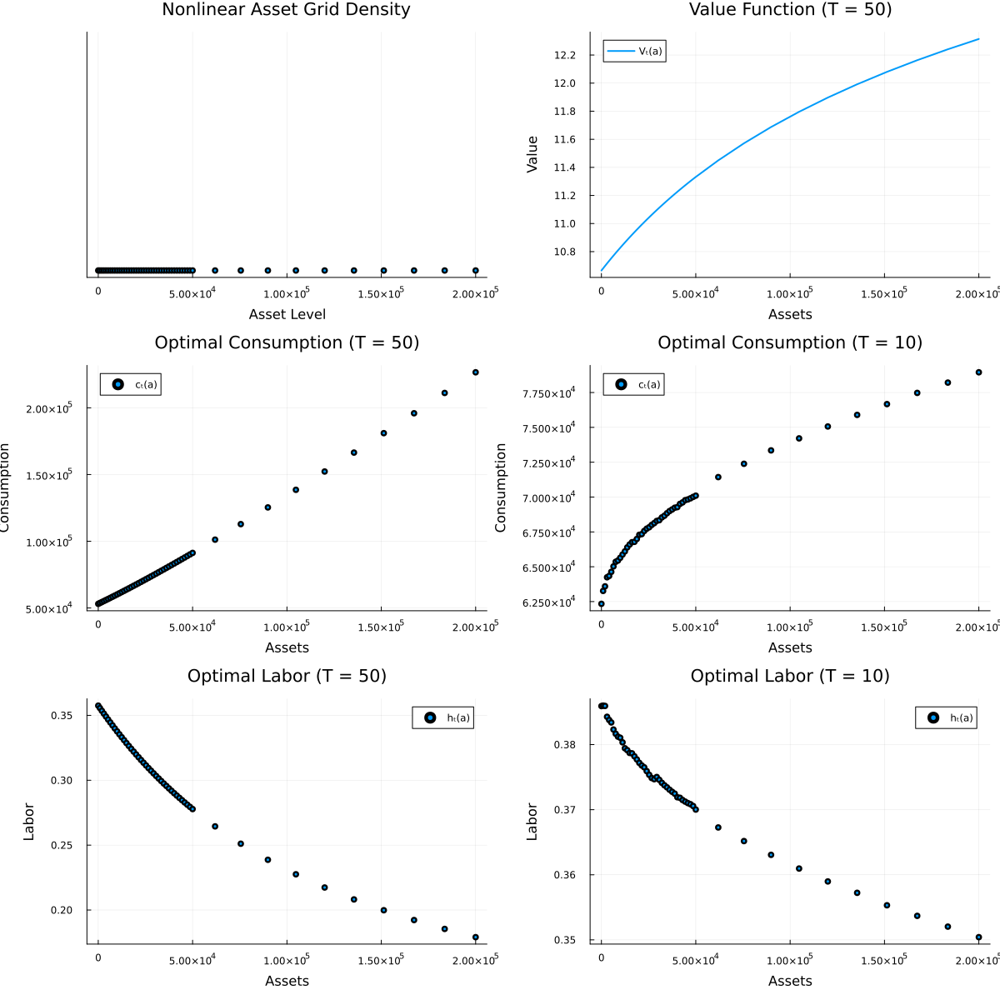

In [211]:

# Choose a representative labor grid index (e.g. the median)
k_mid = Int(ceil(length(model_baseline.k_grid)/2))
T_terminal = model_baseline.T  # Terminal period (e.g., 50)
t_early = 10          # An earlier period for comparison

# 1. Plot the nonlinear asset grid
p1 = scatter(model_baseline.a_grid, zeros(length(model_baseline.a_grid)),
    xlabel = "Asset Level",
    yticks = [],
    title = "Nonlinear Asset Grid Density",
    markersize = 3,
    legend = false)

# 2. Plot optimal consumption policy at terminal period (T = model.T)
# Here we fix the labor dimension at k_mid.
p2 = scatter(model_baseline.a_grid, model_baseline.sol_c_work[T_terminal, :, k_mid],
    xlabel = "Assets",
    ylabel = "Consumption",
    title = "Optimal Consumption (T = $(T_terminal))",
    label = "cₜ(a)",
    markersize = 3)

# 3. Plot value function at terminal period (T = model.T)
# Note: use 'sol_v' (not sol_V) as per your definition.
p3 = plot(model_baseline.a_grid, model_baseline.sol_v_work[T_terminal, :, k_mid],
    xlabel = "Assets",
    ylabel = "Value",
    title = "Value Function (T = $(T_terminal))",
    label = "Vₜ(a)",
    linewidth = 2)

# 4. Plot optimal consumption policy at an earlier period (e.g., T = 10)
p4 = scatter(model_baseline.a_grid, model_baseline.sol_c_work[t_early, :, k_mid],
    xlabel = "Assets",
    ylabel = "Consumption",
    title = "Optimal Consumption (T = $(t_early))",
    label = "cₜ(a)",
    markersize = 3)

p5 = scatter(model_baseline.a_grid, model_baseline.sol_h_work[t_early, :, k_mid],
    xlabel = "Assets",
    ylabel = "Labor",
    title = "Optimal Labor (T = $(t_early))",
    label = "hₜ(a)",
    markersize = 3)

p6 = scatter(model_baseline.a_grid, model_baseline.sol_h_work[T_terminal, :, k_mid],
    xlabel = "Assets",
    ylabel = "Labor",
    title = "Optimal Labor (T = $(T_terminal))",
    label = "hₜ(a)",
    markersize = 3)

# Combine all plots into a 2×2 grid layout for comparison
plot(p1, p3, p2, p4, p6, p5, layout = (3, 2), size = (1200, 1200))

### Variable Distribution Comparison Over Time 
This script defines a function that plots the distributions of a given variable (e.g., Assets and Consumption) at selected time periods. It creates uniform histograms with consistent x‑ and y‑axis limits and arranges them in a 2×2 grid using a colorful, enhanced visualization style for direct comparison.

In [86]:
function extract_distribution_arrays(model, path_choice)
    college_idx = findall(x -> x == :college, path_choice)
    work_idx    = findall(x -> x == :work, path_choice)

    return (
        assets_college      = model.sim_a[college_idx, :],
        assets_work         = model.sim_a[work_idx, :],
        consumption_college = model.sim_c[college_idx, :],
        consumption_work    = model.sim_c[work_idx, :],
        hours_college       = model.sim_h[college_idx, :],
        hours_work          = model.sim_h[work_idx, :],
        capital_college     = model.sim_k[college_idx, :],
        capital_work        = model.sim_k[work_idx, :],
        income_college      = model.sim_income[college_idx, :],
        income_work         = model.sim_income[work_idx, :]
    )
end;

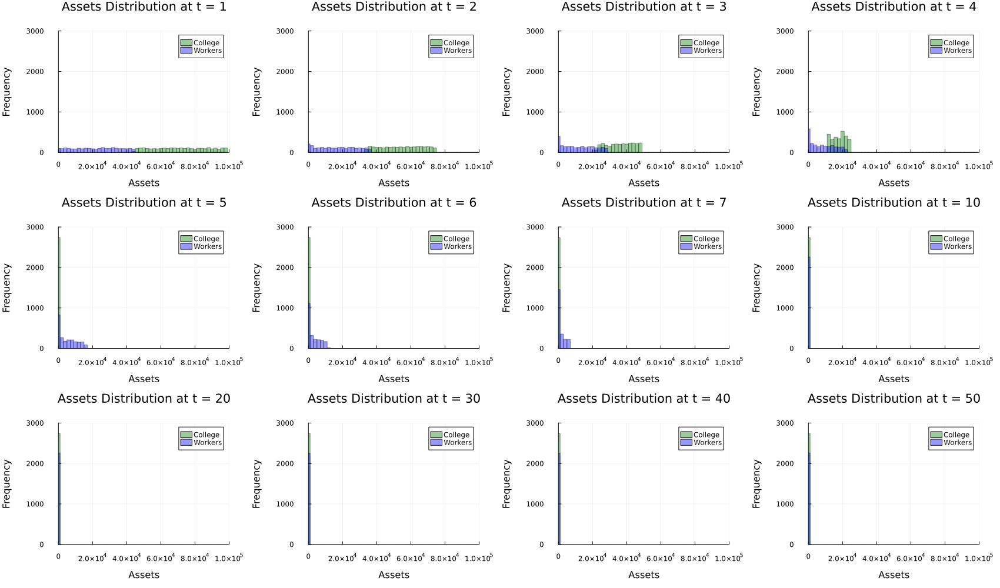

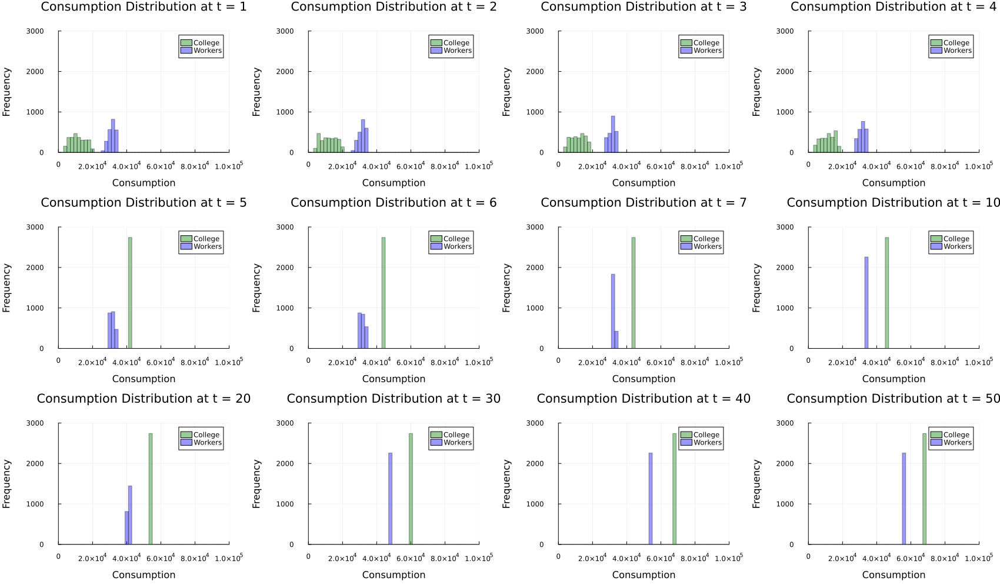

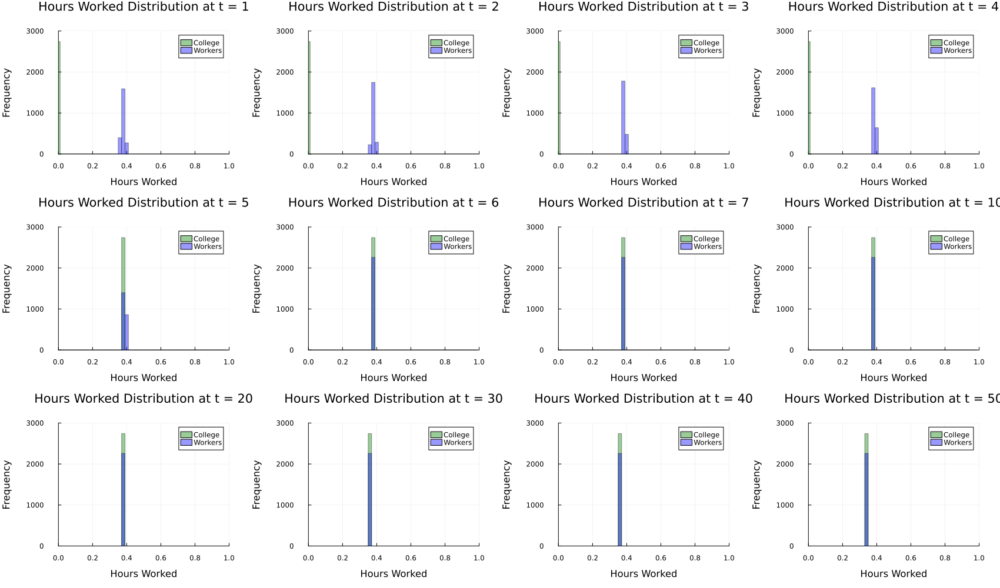

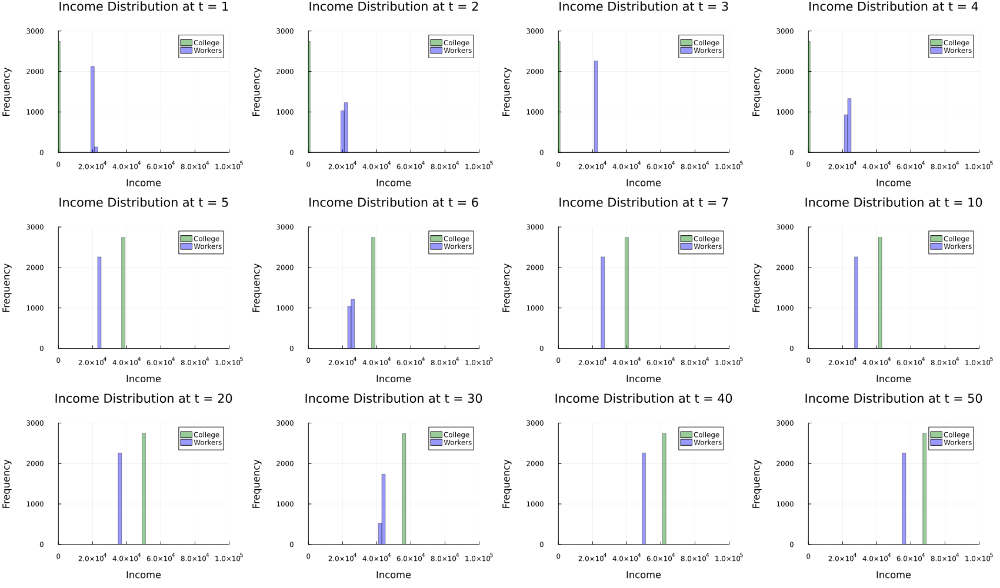

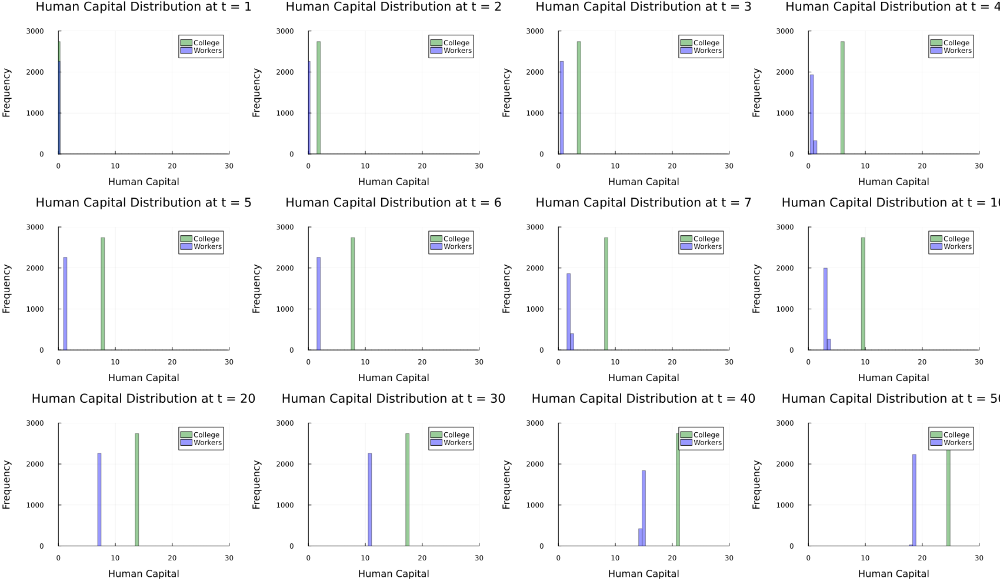

In [87]:
function plot_distribution_over_time(
    var_college, var_work; 
    var_name="Variable", 
    bin_max=100_000, 
    num_bins=50, 
    x_range=nothing,
    y_lim=(0, 1000)  # <-- NEW: manual ylim
)
    # If an x_range is provided, use it; otherwise, use (0, bin_max)
    if isnothing(x_range)
        x_min = 0
        x_max = bin_max
    else
        x_min, x_max = x_range
    end

    time_steps = [1, 2, 3, 4, 5, 6, 7, 10, 20, 30, 40, 50]
    bin_edges = range(x_min, stop=x_max, length=num_bins+1)
    bin_width = bin_edges[2] - bin_edges[1]
    plots = []

    for t in time_steps
        col_vals = var_college[:, t]
        work_vals = var_work[:, t]

        hist_college = fit(Histogram, col_vals, bin_edges)
        hist_work    = fit(Histogram, work_vals, bin_edges)

        p = bar(
            hist_college.edges[1][1:end-1],
            hist_college.weights;
            bar_width = bin_width,
            label = "College",
            color = :green,
            alpha = 0.4,
            xlabel = var_name,
            ylabel = "Frequency",
            title  = "$var_name Distribution at t = $t",
            xlim = (x_min, x_max),
            ylim = y_lim,  # <-- apply manual y-axis limits
            legend = :topright
        )

        bar!(
            p,
            hist_work.edges[1][1:end-1],
            hist_work.weights;
            bar_width = bin_width,
            label = "Workers",
            color = :blue,
            alpha = 0.4
        )

        push!(plots, p)
    end

    combined = plot(
        plots...,
        layout = (3, 4),
        size = (1700, 1000),
        margins = 7mm
    )
    display(combined)
end

arrays = extract_distribution_arrays(model, path_choice)

plot_distribution_over_time(arrays.assets_college, arrays.assets_work; var_name="Assets", x_range=(0, 100_000), y_lim=(0, 3000))
plot_distribution_over_time(arrays.consumption_college, arrays.consumption_work; var_name="Consumption", x_range=(0, 100_000), y_lim=(0, 3000))
plot_distribution_over_time(arrays.hours_college, arrays.hours_work; var_name="Hours Worked", x_range=(0, 1), y_lim=(0, 3000))
plot_distribution_over_time(arrays.income_college, arrays.income_work; var_name="Income", x_range=(0, 100_000), y_lim=(0, 3000))
plot_distribution_over_time(arrays.capital_college, arrays.capital_work; var_name="Human Capital", x_range=(0, 30), y_lim=(0, 3000))

### Average Simulation Paths by Group

This code extracts and visualizes the average time series for key variables (consumption, assets, hours, and capital) for agents grouped by their chosen path (college vs. work). The function `extract_simulation_by_path` computes the mean values at each period for both groups. After running the baseline simulation and capturing the `path_choice` vector, the code generates four plots (one for each variable) and combines them into a 2×2 grid. This visualization facilitates comparing how these state variables evolve over time for agents choosing college versus those choosing work.

In [33]:

# -----------------------------
# Extraction function to compute average time series by group
# -----------------------------
function extract_simulation_by_path(model, path_choice)
    T = model.T
    # Find indices of agents by their choice
    college_idx = findall(x -> x == :college, path_choice)
    work_idx    = findall(x -> x == :work, path_choice)
    
    # Compute the average for each time period over the agents in each group
    avg_c_college = [mean(model.sim_c[college_idx, t]) for t in 1:T]
    avg_c_work    = [mean(model.sim_c[work_idx, t]) for t in 1:T]
    
    avg_a_college = [mean(model.sim_a[college_idx, t]) for t in 1:T]
    avg_a_work    = [mean(model.sim_a[work_idx, t]) for t in 1:T]
    
    avg_h_college = [mean(model.sim_h[college_idx, t]) for t in 1:T]
    avg_h_work    = [mean(model.sim_h[work_idx, t]) for t in 1:T]
    
    avg_k_college = [mean(model.sim_k[college_idx, t]) for t in 1:T]
    avg_k_work    = [mean(model.sim_k[work_idx, t]) for t in 1:T]
    
    avg_income_college = [mean(model.sim_income[college_idx, t]) for t in 1:T]
    avg_income_work    = [mean(model.sim_income[work_idx, t]) for t in 1:T]
    
    avg_wage_college = [mean(model.sim_wage[college_idx, t]) for t in 1:T]
    avg_wage_work    = [mean(model.sim_wage[work_idx, t]) for t in 1:T]
    
    return (
      c      = (college = avg_c_college,   work = avg_c_work),
      a      = (college = avg_a_college,   work = avg_a_work),
      h      = (college = avg_h_college,   work = avg_h_work),
      k      = (college = avg_k_college,   work = avg_k_work),
      income = (college = avg_income_college, work = avg_income_work),
      wage   = (college = avg_wage_college,   work = avg_wage_work)
    )
end

extract_simulation_by_path (generic function with 1 method)

In [34]:

baseline_sim = extract_simulation_by_path(model_baseline, path_choice_baseline)


function plot_simulation_results(model, path_choice, common_title="Counterfactual\n(r increased from X% to Y%)"; baseline_sim=nothing)
    # Extract simulation results for the current model
    sim_results = extract_simulation_by_path(model, path_choice)
    t = 1:model.T  # time vector

    # Colors & line widths
    college_color = :blue
    work_color    = :red
    main_lw       = 1.5
    base_lw       = 1.0

    # Helper for subtle dashed grid lines
    function style_grid!(p)
        plot!(p, grid = :on, gridstyle = :dash, gridcolor = :gray, gridalpha = 0.5)
    end

    # Formatter to divide y-values by 1000 (e.g., 60000 → "60")
    thousand_formatter = (val -> @sprintf("%.0f", val/1_000))

    ## ------------------- PLOT 1: Consumption ------------------- ##
    # Plot main lines in solid, baseline in dashed
    ymax_c = maximum(vcat(sim_results.c.college, sim_results.c.work)) * 1.05  # 10% buffer
    p1 = plot(t, sim_results.c.college,
        label = "College", lw = main_lw, color = college_color,
        xlabel = "Time", ylabel = "Consumption (×10³)", ylims = (0, ymax_c),
        title  = "Consumption", legend = :bottomright,
    )
    plot!(p1, t, sim_results.c.work,
        label = "Work", lw = main_lw, color = work_color)

    if baseline_sim !== nothing
        plot!(p1, t, baseline_sim.c.college,
            label = "College (Base)", lw = base_lw, color = college_color,
            linestyle = :dash)
        plot!(p1, t, baseline_sim.c.work,
            label = "Work (Base)", lw = base_lw, color = work_color,
            linestyle = :dash)
    end
    # Apply thousands formatter
    plot!(p1, yformatter = thousand_formatter)
    style_grid!(p1)

    ## ------------------- PLOT 2: Assets ------------------- ##
    p2 = plot(t, sim_results.a.college,
        label = "College", lw = main_lw, color = college_color,
        xlabel = "Time", ylabel = "Assets (×10³)",
        title = "Assets"
    )
    plot!(p2, t, sim_results.a.work,
        label = "Work", lw = main_lw, color = work_color)

    if baseline_sim !== nothing
        plot!(p2, t, baseline_sim.a.college,
            label = "College (Base)", lw = base_lw, color = college_color,
            linestyle = :dash)
        plot!(p2, t, baseline_sim.a.work,
            label = "Work (Base)", lw = base_lw, color = work_color,
            linestyle = :dash)
    end
    # Thousands
    plot!(p2, yformatter = thousand_formatter)
    style_grid!(p2)

    ## ------------------- PLOT 3: Hours ------------------- ##
    # Hours are presumably small, so we don't scale
    p3 = plot(t, sim_results.h.college,
        label = "College", lw = main_lw, color = college_color,
        xlabel = "Time", ylabel = "Hours", ylim = (0, 0.45),
        title = "Hours"
    )
    plot!(p3, t, sim_results.h.work,
        label = "Work", lw = main_lw, color = work_color)

    if baseline_sim !== nothing
        plot!(p3, t, baseline_sim.h.college,
            label = "College (Base)", lw = base_lw, color = college_color,
            linestyle = :dash)
        plot!(p3, t, baseline_sim.h.work,
            label = "Work (Base)", lw = base_lw, color = work_color,
            linestyle = :dash)
    end
    # No thousands scaling
    style_grid!(p3)

    ## ------------------- PLOT 4: Human Capital ------------------- ##
    p4 = plot(t, sim_results.k.college,
        label = "College", lw = main_lw, color = college_color,
        xlabel = "Time", ylabel = "Human Capital", #ylims = (0, 55),
        title = "Human Capital"
    )
    plot!(p4, t, sim_results.k.work,
        label = "Work", lw = main_lw, color = work_color)

    if baseline_sim !== nothing
        plot!(p4, t, baseline_sim.k.college,
            label = "College (Base)", lw = base_lw, color = college_color,
            linestyle = :dash)
        plot!(p4, t, baseline_sim.k.work,
            label = "Work (Base)", lw = base_lw, color = work_color,
            linestyle = :dash)
    end
    # Usually doesn't need thousands scaling, but you can add if your scale is large
    style_grid!(p4)

    ## ------------------- PLOT 5: Income ------------------- ##
    p5 = plot(t, sim_results.income.college,
        label = "College", lw = main_lw, color = college_color,
        xlabel = "Time", ylabel = "Income (×10³)",
        title = "Income"
    )
    plot!(p5, t, sim_results.income.work,
        label = "Work", lw = main_lw, color = work_color)

    if baseline_sim !== nothing
        plot!(p5, t, baseline_sim.income.college,
            label = "College (Base)", lw = base_lw, color = college_color,
            linestyle = :dash)
        plot!(p5, t, baseline_sim.income.work,
            label = "Work (Base)", lw = base_lw, color = work_color,
            linestyle = :dash)
    end
    # Use thousands
    plot!(p5, yformatter = thousand_formatter)
    style_grid!(p5)

    ## ------------------- PLOT 6: Wage ------------------- ##
    p6 = plot(t, sim_results.wage.college,
        label = "College", lw = main_lw, color = college_color,
        xlabel = "Time", ylabel = "Wage",
        title = "Wage"
    )
    plot!(p6, t, sim_results.wage.work,
        label = "Work", lw = main_lw, color = work_color)

    if baseline_sim !== nothing
        plot!(p6, t, baseline_sim.wage.college,
            label = "College (Base)", lw = base_lw, color = college_color,
            linestyle = :dash)
        plot!(p6, t, baseline_sim.wage.work,
            label = "Work (Base)", lw = base_lw, color = work_color,
            linestyle = :dash)
    end
    # Thousands
    plot!(p6)
    style_grid!(p6)

    # Combine the six subplots into a 2x3 layout
    combined_plot = plot(
        p1, p2, p3, p4, p5, p6,
        layout     = (3, 2),
        size       = (1000, 1300),
        plot_title = common_title,
        titlefont  = 16,
        margin     = 5mm
    )

    return combined_plot
end

plot_simulation_results (generic function with 2 methods)

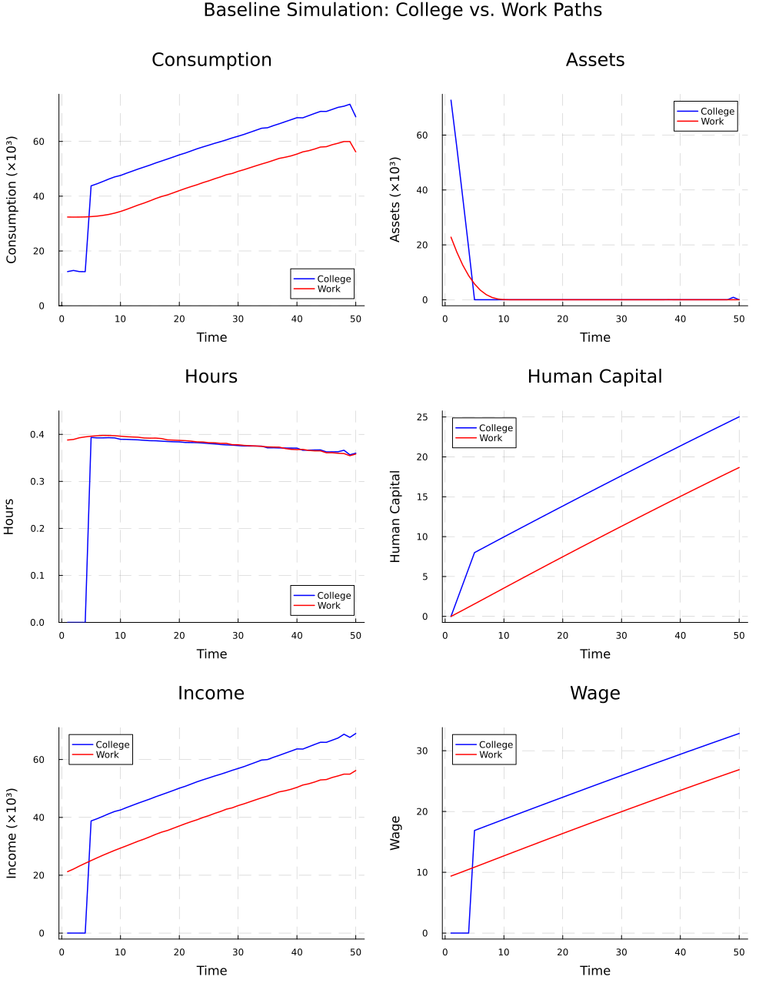

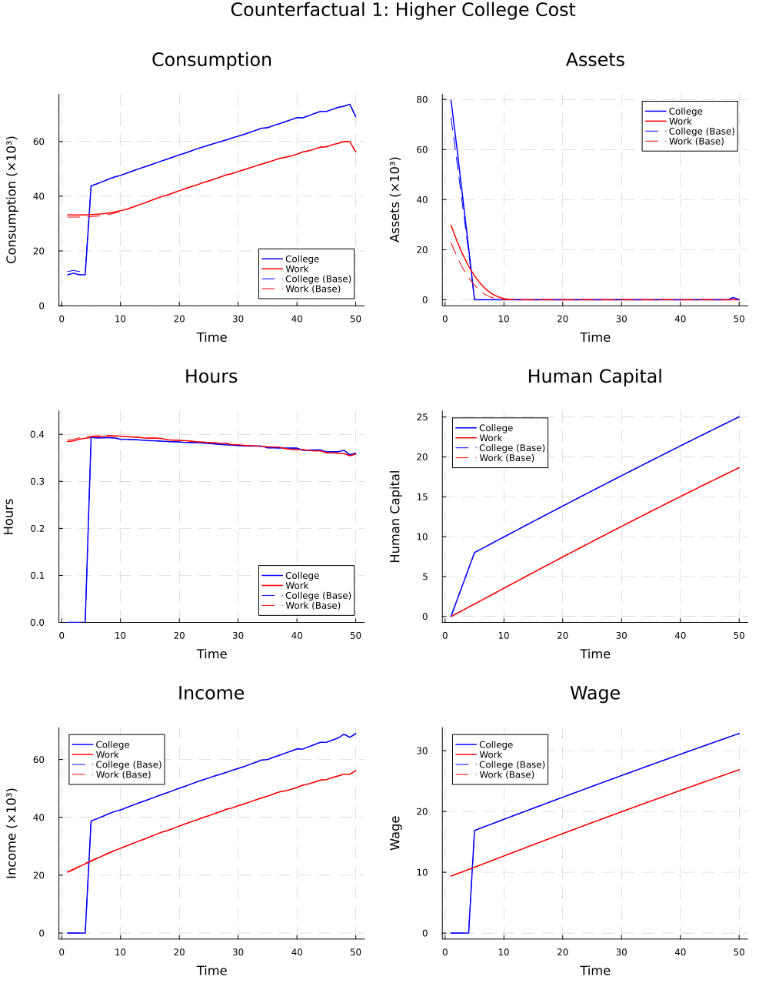

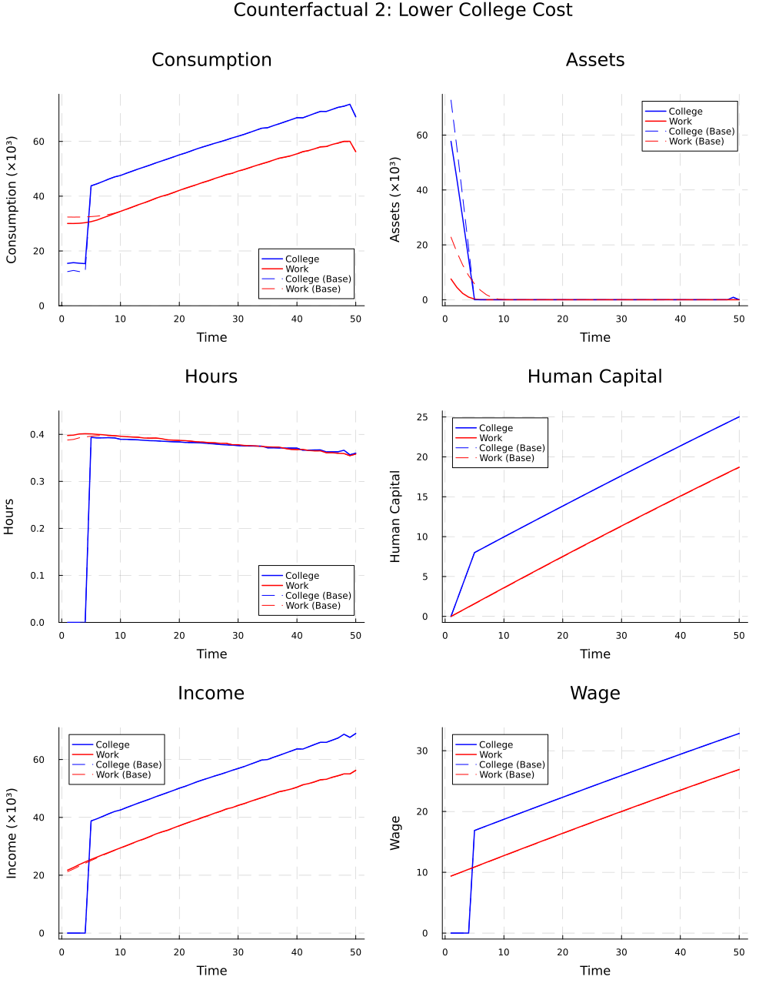

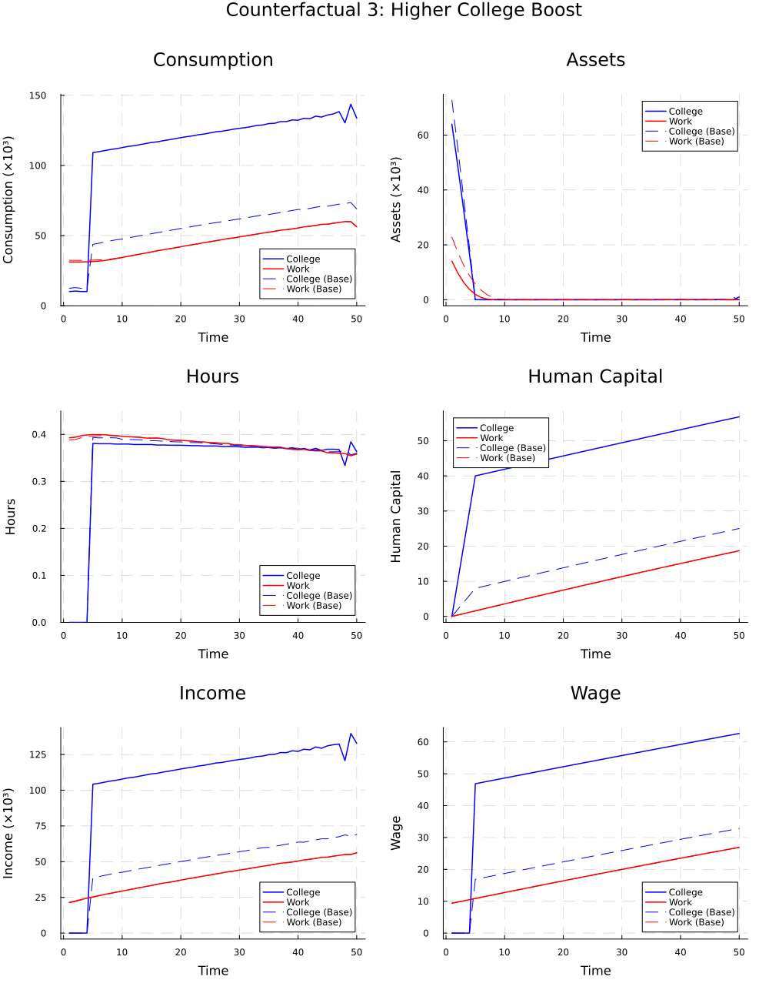

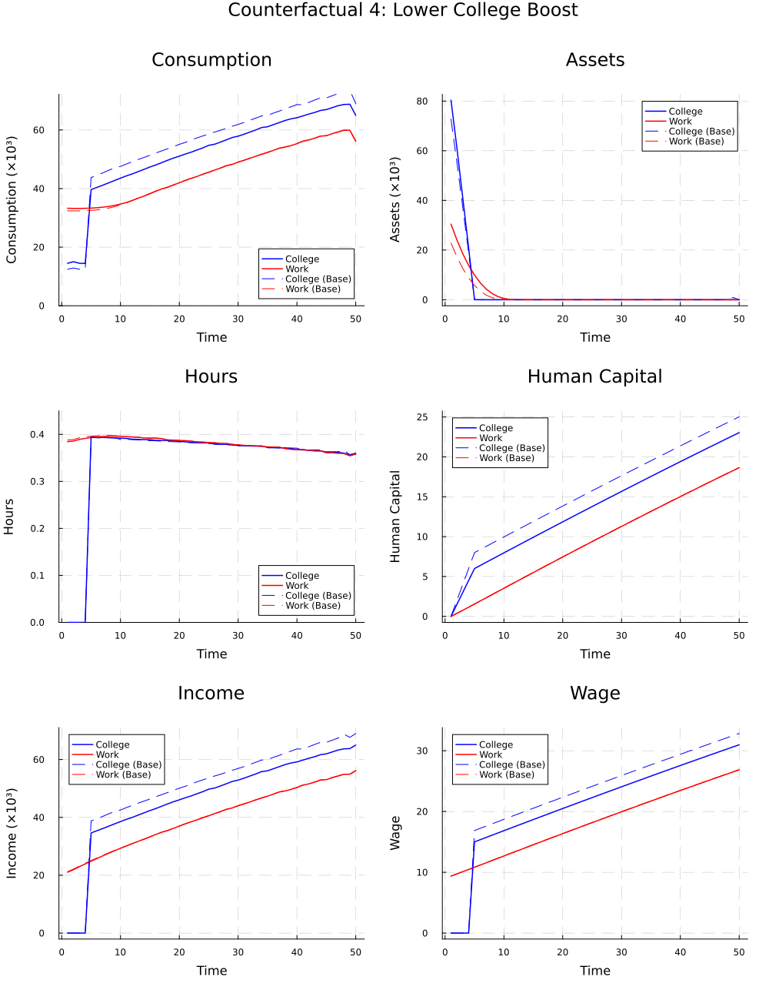

...

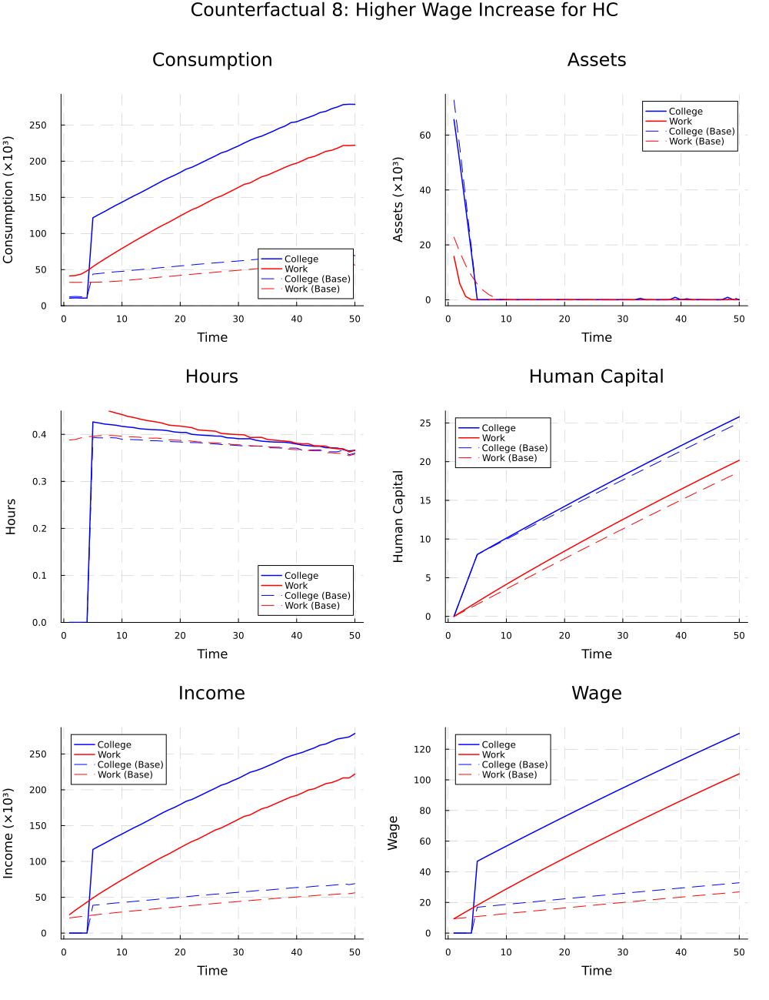

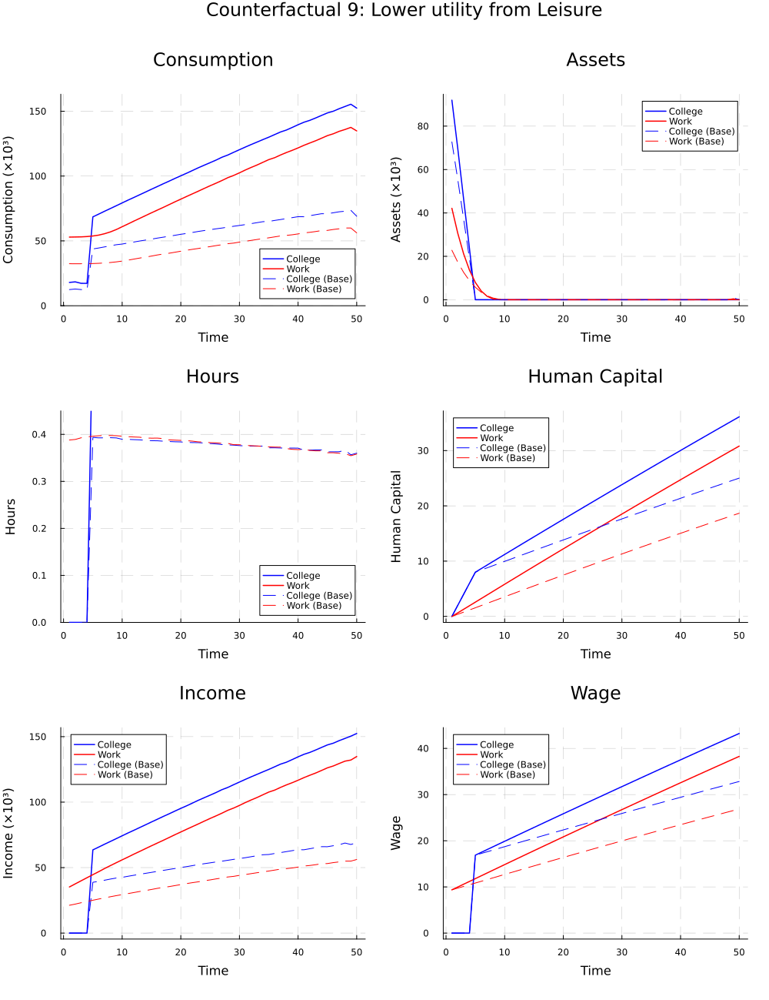

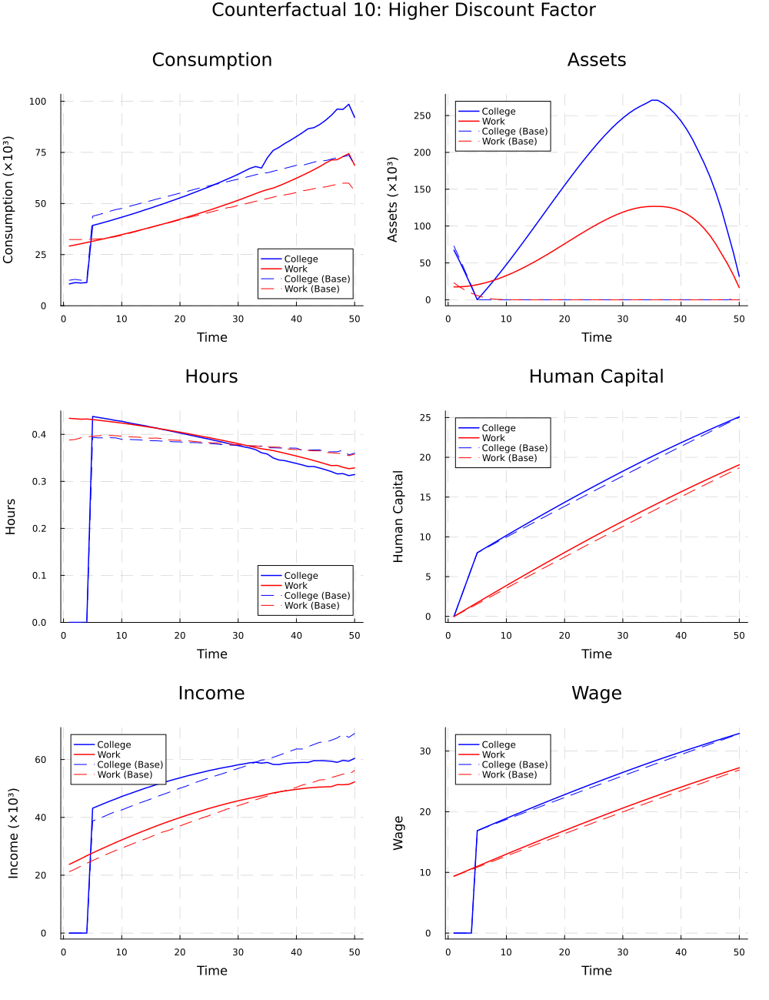

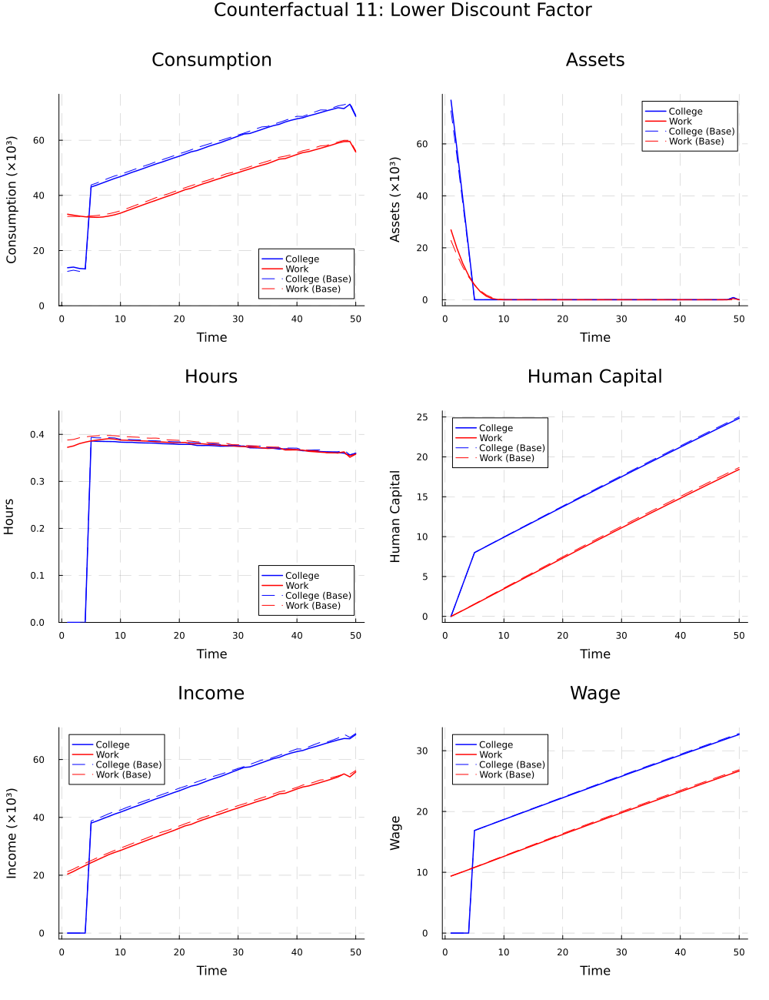

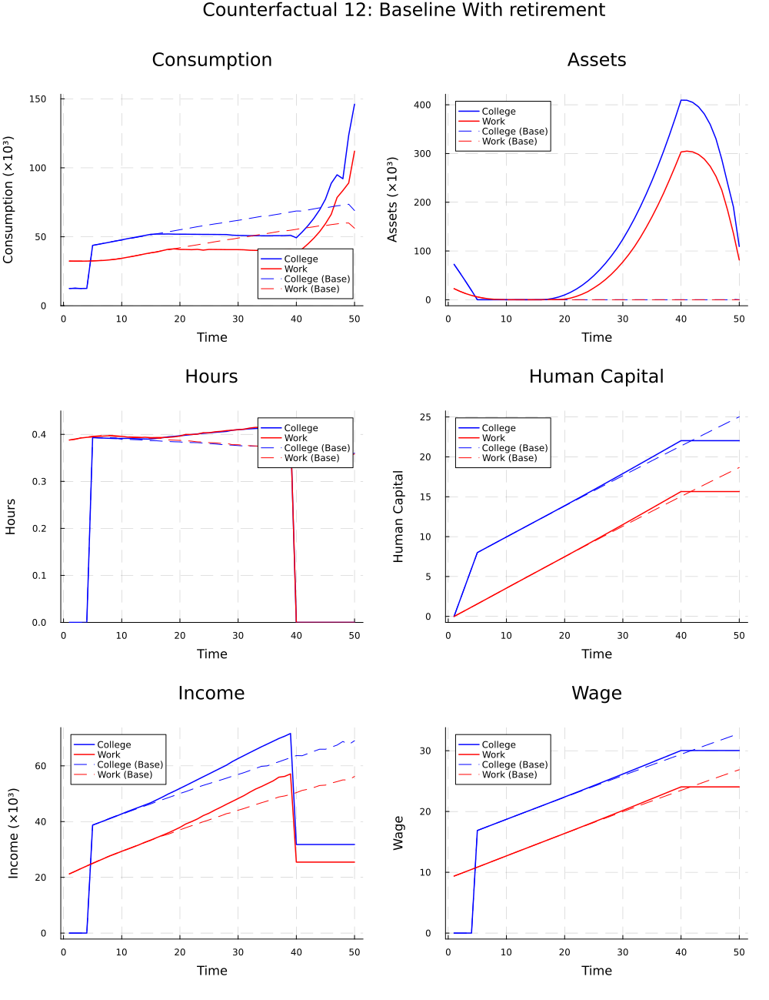

In [232]:
p_baseline = plot_simulation_results(model_baseline, path_choice_baseline,
                                     "Baseline Simulation: College vs. Work Paths")
p_cf1 = plot_simulation_results(model_cf1, path_choice_cf1,
                                "Counterfactual 1: Higher College Cost";
                                baseline_sim = baseline_sim)
p_cf2 = plot_simulation_results(model_cf2, path_choice_cf2,
                                "Counterfactual 2: Lower College Cost";
                                baseline_sim = baseline_sim)
p_cf3 = plot_simulation_results(model_cf3, path_choice_cf3,
                                "Counterfactual 3: Higher College Boost";
                                baseline_sim = baseline_sim)
p_cf4 = plot_simulation_results(model_cf4, path_choice_cf4,
                                "Counterfactual 4: Lower College Boost";
                                baseline_sim = baseline_sim)
p_cf5 = plot_simulation_results(model_cf5, path_choice_cf5,
                                "Counterfactual 5: Higher Interest Rate";
                                baseline_sim = baseline_sim)
p_cf6 = plot_simulation_results(model_cf6, path_choice_cf6,
                                "Counterfactual 6: Lower Interest Rate";
                                baseline_sim = baseline_sim)
p_cf7 = plot_simulation_results(model_cf7, path_choice_cf7,
                                "Counterfactual 7: Lower Wage Increase for HC";
                                baseline_sim = baseline_sim)
p_cf8 = plot_simulation_results(model_cf8, path_choice_cf8,
                                "Counterfactual 8: Higher Wage Increase for HC";
                                baseline_sim = baseline_sim)
p_cf9 = plot_simulation_results(model_cf9, path_choice_cf9,
                                "Counterfactual 9: Lower utility from Leisure";
                                baseline_sim = baseline_sim)
p_cf10 = plot_simulation_results(model_cf10, path_choice_cf10,
                                 "Counterfactual 10: Higher Discount Factor";
                                 baseline_sim = baseline_sim)
p_cf11 = plot_simulation_results(model_cf11, path_choice_cf11,
                                 "Counterfactual 11: Lower Discount Factor";
                                 baseline_sim = baseline_sim)
p_cf12 = plot_simulation_results(model_baseline_retire, path_choice_retirement,
                                 "Counterfactual 12: Baseline With retirement";
                                 baseline_sim = baseline_sim)
# --------------------------



# Display each plot. You can comment/uncomment based on what you wish to view.
display(p_baseline)
display(p_cf1)
display(p_cf2)
display(p_cf3)
display(p_cf4)
display(p_cf5)
display(p_cf6)
display(p_cf7)
display(p_cf8)
display(p_cf9)
display(p_cf10)
display(p_cf11)
display(p_cf12)

In [ ]:
# visiualize the labor supply policy function for all the periods to see how it changes over time
gr()  # or your preferred backend

a_grid = model_baseline.a_grid
sol_h = model_baseline.sol_h_work
T = model_baseline.T
k_mid = Int(ceil(length(model_baseline.k_grid) / 2))  # pick a representative labor/skill state

plots = []

for t in 1:T
    p = scatter(a_grid, sol_h[t, :, k_mid],
        xlabel = "Assets",
        ylabel = "Labor",
        title = "T = $t",
        label = false,
        markersize = 2,
        tickfontsize=6)
    push!(plots, p)
end

# Layout: adjust number of columns depending on how many you want per row
ncols = 5
plot(plots..., layout = (ceil(Int, T / ncols), ncols), size = (300 * ncols, 250 * ceil(Int, T / ncols)))

### Model with Retirement

In [224]:
mutable struct ConSavLaborCollege_retirement
    T::Int                     # Total number of periods
    t_college::Int             # Number of college periods
    rho::Float64               # Risk aversion parameter
    beta::Float64              # Discount factor
    phi::Float64               # Disutility of labor parameter
    eta::Float64               # Preference parameter
    alpha::Float64             # Wage increase per year of human capital
    y::Float64                 # Non-labor income
    w::Float64                 # Base wage level
    tau::Float64               # Tax rate on wage income
    r::Float64                 # Interest rate on assets
    a_max::Float64             # Maximum asset level
    a_min::Float64             # Minimum asset level (borrowing constraint)
    Na::Int                    # Number of grid points for assets
    k_max::Float64             # Maximum human capital level
    Nk::Int                    # Number of grid points for human capital
    simT::Int                  # Number of simulation periods
    simN::Int                  # Number of simulation agents
    a_grid::Vector{Float64}    # Grid for assets
    k_grid::Vector{Float64}    # Grid for human capital

    # Solution arrays for working alternative
    sol_c_work::Array{Float64, 3}  
    sol_h_work::Array{Float64, 3}  
    sol_v_work::Array{Float64, 3}  

    # Solution arrays for college alternative
    sol_c_college::Array{Float64, 3}  
    sol_h_college::Array{Float64, 3}  
    sol_v_college::Array{Float64, 3}  

    # Simulation arrays
    sim_c::Matrix{Float64}      
    sim_h::Matrix{Float64}      
    sim_a::Matrix{Float64}      
    sim_k::Matrix{Float64}      
    sim_a_init::Vector{Float64} 
    sim_k_init::Vector{Float64} 
    sim_income::Matrix{Float64} 
    sim_wage::Matrix{Float64}   
    
    draws_uniform::Matrix{Float64}  
    w_vec::Vector{Float64}          
    college_cost::Float64           
    college_boost::Float64
    
    t_retire::Int                # Retirement time
    h_avg::Float64               # Average labor effort (initialized to 0)
end

function ConSavLaborCollege_retirement(; 
    T::Int=50, 
    t_college::Int=4, 
    beta::Float64=0.97, 
    rho::Float64=1.0, 
    r::Float64=0.03, 
    a_max::Float64=1000000.0, 
    Na::Int=50, 
    simN::Int=5000, 
    a_min::Float64=0.0, 
    k_max::Float64=30.0, 
    Nk::Int=50,
    y::Float64=5000.0, 
    w::Float64=12.5, 
    tau::Float64=0.25, 
    eta::Float64=2.0, 
    alpha::Float64=0.1, 
    phi::Float64=20.0, 
    seed::Int=1234, 
    college_cost::Float64=12000.0, 
    college_boost::Float64=2.0,
    t_retire::Int=40,
    h_avg::Float64=h_avg)  # Default average hours for pension
    
    simT = T
    a_grid = create_focused_grid(a_min, 100000.0, a_max, Na, 0.8, 1.1)
    k_grid = nonlinspace(0.0, k_max, Nk, 1.5)    

    sol_c_work = fill(NaN, (T, Na, Nk))
    sol_h_work = fill(NaN, (T, Na, Nk))
    sol_v_work = fill(NaN, (T, Na, Nk))

    sol_c_college = fill(NaN, (T, Na, Nk))
    sol_h_college = fill(NaN, (T, Na, Nk))
    sol_v_college = fill(NaN, (T, Na, Nk))

    sim_c = fill(NaN, (simN, T))
    sim_h = fill(NaN, (simN, T))
    sim_a = fill(NaN, (simN, T))
    sim_k = fill(NaN, (simN, T))

    rng = MersenneTwister(seed)
    sim_a_init = rand(rng, simN) .* 100000
    sim_k_init = zeros(Float64, simN)
    sim_income = fill(NaN, (simN, T))
    sim_wage = fill(NaN, (simN, T))

    w_vec = fill(w, T)
    draws_uniform = rand(rng, simN, T)
    
    return ConSavLaborCollege_retirement(
        T, t_college, rho, beta, phi, eta, alpha, y, w, tau, r,
        a_max, a_min, Na, k_max, Nk, simT, simN, a_grid, k_grid,
        sol_c_work, sol_h_work, sol_v_work, sol_c_college, sol_h_college, sol_v_college,
        sim_c, sim_h, sim_a, sim_k, sim_a_init, sim_k_init, sim_income, sim_wage,
        draws_uniform, w_vec, college_cost, college_boost, t_retire, h_avg
    )
end

function solve_model_college!(model::ConSavLaborCollege_retirement)
    T, Na, Nk = model.T, model.Na, model.Nk
    a_grid, k_grid = model.a_grid, model.k_grid
    sol_c, sol_h, sol_v = model.sol_c_college, model.sol_h_college, model.sol_v_college
    t_retire, h_avg = model.t_retire, model.h_avg

    # Final period (t = T), during retirement
    for i_a in 1:Na
        for i_k in 1:Nk
            assets = a_grid[i_a]
            capital = k_grid[i_k]
            wage = wage_func(model, capital, T)
            pension = 0.5 * wage * h_avg
            cons = assets + pension + model.y
            sol_h[T, i_a, i_k] = 0.0
            sol_c[T, i_a, i_k] = cons
            sol_v[T, i_a, i_k] = util_retire(model, cons)
        end
    end

    # Retirement periods (t = T-1 to t_retire)
    for t in (T-1):-1:t_retire
        interp = create_interp(model, sol_v, t + 1)
        for i_a in 1:Na
            for i_k in 1:Nk
                assets = a_grid[i_a]
                capital = k_grid[i_k]
                wage = wage_func(model, capital, t)
                pension = 0.5 * wage * h_avg
                function obj_retire(x::Vector{Float64}, grad::Vector{Float64})
                    c = x[1]
                    return -value_of_retirement_choice(model, c, assets, capital, t, interp)
                end
                opt = Opt(:LN_COBYLA, 1)
                lower_bounds!(opt, [1e-6])
                upper_bounds!(opt, [assets + pension + 1e6])
                ftol_rel!(opt, 1e-8)
                min_objective!(opt, obj_retire)
                init = [sol_c[t + 1, i_a, i_k]]
                (minf, c_opt, ret) = optimize(opt, init)
                sol_c[t, i_a, i_k] = c_opt[1]
                sol_h[t, i_a, i_k] = 0.0
                sol_v[t, i_a, i_k] = -minf
            end
        end
    end

    # Work periods (t = t_retire-1 to t_college+1)
    for t in (t_retire-1):-1:(model.t_college + 1)
        interp = create_interp(model, sol_v, t + 1)
        for i_a in 1:Na
            for i_k in 1:Nk
                assets = a_grid[i_a]
                capital = k_grid[i_k]
                function obj_work(x::Vector{Float64}, grad::Vector{Float64})
                    c, h = x[1], x[2]
                    return -value_of_work_choice(model, c, h, assets, capital, t, interp)
                end
                opt = Opt(:LN_COBYLA, 2)
                lower_bounds!(opt, [1e-6, 0.0])
                upper_bounds!(opt, [Inf, 1.0])
                ftol_rel!(opt, 1e-8)
                min_objective!(opt, obj_work)
                init = [sol_c[t + 1, i_a, i_k], sol_h[t + 1, i_a, i_k]]
                (minf, x_opt, ret) = optimize(opt, init)
                sol_c[t, i_a, i_k] = x_opt[1]
                sol_h[t, i_a, i_k] = x_opt[2]
                sol_v[t, i_a, i_k] = -minf
            end
        end
    end

    # College periods (t = t_college to 1)
    for t in model.t_college:-1:1
        interp = create_interp(model, sol_v, t + 1)
        for i_a in 1:Na
            for i_k in 1:Nk
                assets = a_grid[i_a]
                capital = k_grid[i_k]
                function obj_college(x::Vector{Float64}, grad::Vector{Float64})
                    c = x[1]
                    return -value_of_college_choice(model, c, assets, capital, t, interp)
                end
                opt = Opt(:LN_COBYLA, 1)
                lower_bounds!(opt, [1e-6])
                upper_bounds!(opt, [Inf])
                ftol_rel!(opt, 1e-8)
                min_objective!(opt, obj_college)
                init = [max(sol_c[t + 1, i_a, i_k], 1e-6)]
                (minf, c_opt, ret) = optimize(opt, init)
                sol_c[t, i_a, i_k] = c_opt[1]
                sol_h[t, i_a, i_k] = 0.0
                sol_v[t, i_a, i_k] = -minf
            end
        end
    end

    return model
end

function solve_model_work!(model::ConSavLaborCollege_retirement)
    T, Na, Nk = model.T, model.Na, model.Nk
    a_grid, k_grid = model.a_grid, model.k_grid
    sol_c, sol_h, sol_v = model.sol_c_work, model.sol_h_work, model.sol_v_work
    t_retire, h_avg = model.t_retire, model.h_avg

    # Final period (t = T), during retirement
    for i_a in 1:Na
        for i_k in 1:Nk
            assets = a_grid[i_a]
            capital = k_grid[i_k]
            wage = wage_func(model, capital, T)
            pension = 0.5 * wage * h_avg
            cons = assets + pension + model.y
            sol_h[T, i_a, i_k] = 0.0
            sol_c[T, i_a, i_k] = cons
            sol_v[T, i_a, i_k] = util_retire(model, cons)
        end
    end

    # Retirement periods (t = T-1 to t_retire)
    for t in (T-1):-1:t_retire
        interp = create_interp(model, sol_v, t + 1)
        for i_a in 1:Na
            for i_k in 1:Nk
                assets = a_grid[i_a]
                capital = k_grid[i_k]
                wage = wage_func(model, capital, t)
                pension = 0.5 * wage * model.h_avg
                function obj_retire(x::Vector{Float64}, grad::Vector{Float64})
                    c = x[1]
                    return -value_of_retirement_choice(model, c, assets, capital, t, interp)
                end
                opt = Opt(:LN_COBYLA, 1)
                lower_bounds!(opt, [1e-6])
                upper_bounds!(opt, [assets + pension + 1e6])
                ftol_rel!(opt, 1e-6)
                min_objective!(opt, obj_retire)
                init = [sol_c[t + 1, i_a, i_k]]
                (minf, c_opt, ret) = optimize(opt, init)
                sol_c[t, i_a, i_k] = c_opt[1]
                sol_h[t, i_a, i_k] = 0.0
                sol_v[t, i_a, i_k] = -minf
            end
        end
    end

    # Work periods (t = t_retire-1 to 1)
    for t in (t_retire-1):-1:1
        interp = create_interp(model, sol_v, t + 1)
        for i_a in 1:Na
            for i_k in 1:Nk
                assets = a_grid[i_a]
                capital = k_grid[i_k]
                function obj_work(x::Vector{Float64}, grad::Vector{Float64})
                    c, h = x[1], x[2]
                    return -value_of_work_choice(model, c, h, assets, capital, t, interp)
                end
                opt = Opt(:LN_COBYLA, 2)
                lower_bounds!(opt, [1e-6, 0.0])
                upper_bounds!(opt, [Inf, 1.0])
                ftol_rel!(opt, 1e-6)
                min_objective!(opt, obj_work)
                init = [sol_c[t + 1, i_a, i_k], sol_h[t + 1, i_a, i_k]]
                (minf, x_opt, ret) = optimize(opt, init)
                sol_c[t, i_a, i_k] = x_opt[1]
                sol_h[t, i_a, i_k] = x_opt[2]
                sol_v[t, i_a, i_k] = -minf
            end
        end
    end

    return model
end

# Supporting functions remain unchanged
@inline function util_work(model::ConSavLaborCollege_retirement, c, h)
    if model.rho == 1.0
        cons_utility = log(c)
    else
        cons_utility = (c^(1.0 - model.rho)) / (1.0 - model.rho)
    end
    labor_disutility = model.phi * (h^(1.0 + model.eta)) / (1.0 + model.eta)
    return cons_utility - labor_disutility
end

# Utility function for college periods with No labor disutility
@inline function util_college(model::ConSavLaborCollege_retirement, c::Float64)
    return log(c) # - pychic cost
end

@inline function util_retire(model::ConSavLaborCollege_retirement, c::Float64)
    return log(c)
end

@inline function wage_func(model::ConSavLaborCollege_retirement, k::Float64, t::Int)
    return (1.0 - model.tau) * model.w_vec[t] * (1.0 + model.alpha * k) * 5840
end

function value_of_college_choice(model::ConSavLaborCollege_retirement, c::Float64, assets::Float64, capital::Float64, t::Int, interp)
    penalty_c = c < 0.0 ? (abs(c)^2) * 1.0e6 : 0.0
    a_next = (1.0 + model.r) * assets - c - model.college_cost + model.y
    penalty_a = a_next < model.a_min ? (model.a_min - a_next) * 1.0e6 : 0.0
    util_now = util_college(model, c)
    k_next = capital + model.college_boost
    V_next = interp(a_next, k_next)
    return util_now + model.beta * V_next - penalty_c - penalty_a
end

function value_of_work_choice(model::ConSavLaborCollege_retirement, c::Float64, h::Float64, assets::Float64, capital::Float64, t::Int, interp)
    penalty_c = c < 0.0 ? (abs(c)^2) * 1.0e7 : 0.0
    penalty_h = h < 0.0 ? (abs(h)^2) * 1.0e8 : 0.0
    income = wage_func(model, capital, t) * h
    a_next = (1.0 + model.r) * assets + income - c + model.y
    penalty_a = a_next < model.a_min ? (model.a_min - a_next) * 1.0e14 : 0.0
    util_now = util_work(model, c, h)
    k_next = capital + h
    V_next = interp(a_next, k_next)
    return util_now + model.beta * V_next - penalty_c - penalty_h - penalty_a
end

function value_of_retirement_choice(model::ConSavLaborCollege_retirement, c::Float64, assets::Float64, capital::Float64, t::Int, interp)
    penalty_c = c < 0.0 ? (abs(c)^2) * 1.0e7 : 0.0
    a_next = (1.0 + model.r) * assets - c + model.y
    penalty_a = a_next < model.a_min ? (model.a_min - a_next) * 1.0e14 : 0.0
    util_now = util_retire(model, c)
    V_next = interp(a_next, capital)
    return util_now + model.beta * V_next - penalty_c - penalty_a
end



function create_interp(model::ConSavLaborCollege_retirement, sol_v::Array{Float64, 3}, t::Int)
    return LinearInterpolation((model.a_grid, model.k_grid), sol_v[t, :, :], extrapolation_bc=Line())
end

function simulate_model!(model::ConSavLaborCollege_retirement)
    # Extract model parameters and simulation variables
    simN, T = model.simN, model.T
    a_max, k_max = model.a_max, model.k_max
    t_college = model.t_college
    r = model.r
    college_cost = model.college_cost
    college_boost = model.college_boost
    a_min = model.a_min
    sim_c, sim_h = model.sim_c, model.sim_h
    sim_a, sim_k = model.sim_a, model.sim_k
    sim_a_init = model.sim_a_init
    sim_k_init = model.sim_k_init
    sim_income = model.sim_income  # Matrix for simulated income (simN × T)
    sim_wage = model.sim_wage      # Matrix for simulated wage (simN × T)
    t_retire, h_avg = model.t_retire, model.h_avg

    # Initial conditions
    a0_vec = sim_a_init
    k0_vec = sim_k_init

    # Interpolation for value functions to determine education choice
    interp_v_college = LinearInterpolation((model.a_grid, model.k_grid), model.sol_v_college[1, :, :], extrapolation_bc=Line())
    interp_v_work = LinearInterpolation((model.a_grid, model.k_grid), model.sol_v_work[1, :, :], extrapolation_bc=Line())

    # Determine each agent's education path
    path_choice = Vector{Symbol}(undef, simN)
    for i in 1:simN
        V_college = interp_v_college(a0_vec[i], k0_vec[i])
        V_work = interp_v_work(a0_vec[i], k0_vec[i])
        path_choice[i] = V_college > V_work ? :college : :work
    end

    # Interpolation for policy functions
    interp_c_college = [LinearInterpolation((model.a_grid, model.k_grid), model.sol_c_college[t, :, :], extrapolation_bc=Line()) for t in 1:T]
    interp_h_college = [LinearInterpolation((model.a_grid, model.k_grid), model.sol_h_college[t, :, :], extrapolation_bc=Line()) for t in 1:T]
    interp_c_work = [LinearInterpolation((model.a_grid, model.k_grid), model.sol_c_work[t, :, :], extrapolation_bc=Line()) for t in 1:T]
    interp_h_work = [LinearInterpolation((model.a_grid, model.k_grid), model.sol_h_work[t, :, :], extrapolation_bc=Line()) for t in 1:T]

    # Set initial assets and human capital
    sim_a[:, 1] = a0_vec
    sim_k[:, 1] = k0_vec

    # Simulation loop over time and agents
    for t in 1:T
        for i in 1:simN
            a = sim_a[i, t]
            k = sim_k[i, t]
            if t >= t_retire
                c = path_choice[i] == :college ? interp_c_college[t](a, k) : interp_c_work[t](a, k)
                h = 0.0
                wage = wage_func(model, k, t) 
                pension = 0.5 * wage * model.h_avg
                sim_income[i, t] = pension
                sim_wage[i, t] = wage / 5840  # Corrected: store wage rate, not pension
            else
                if path_choice[i] == :college && t <= t_college
                    c = interp_c_college[t](a, k)
                    h = interp_h_college[t](a, k)
                    sim_income[i, t] = 0.0
                    sim_wage[i, t] = 0.0
                else
                    c = path_choice[i] == :college ? interp_c_college[t](a, k) : interp_c_work[t](a, k)
                    h = path_choice[i] == :college ? interp_h_college[t](a, k) : interp_h_work[t](a, k)
                    wage = wage_func(model, k, t)
                    sim_income[i, t] = wage * h
                    sim_wage[i, t] = wage / 5840
                end
            end
            sim_c[i, t] = c
            sim_h[i, t] = h
            if t < T
                if t >= t_retire
                    a_next = (1 + r) * a + sim_income[i, t] - c + model.y
                    k_next = k
                elseif path_choice[i] == :college && t <= t_college
                    a_next = (1 + r) * a - c - college_cost + model.y
                    k_next = k + college_boost
                else
                    a_next = (1 + r) * a + sim_income[i, t] - c + model.y
                    k_next = k + h
                end
                sim_a[i, t + 1] = max(a_next, a_min)
                sim_k[i, t + 1] = k_next
            end
        end
    end

    # Assign simulated results back to the model
    model.sim_a = sim_a
    model.sim_c = sim_c
    model.sim_h = sim_h
    model.sim_k = sim_k
    model.sim_income = sim_income  # Store simulated income in model
    model.sim_wage = sim_wage      # Store simulated wage in model

    # Print education choice statistics
    num_college = sum(path_choice .== :college)
    num_work = sum(path_choice .== :work)
    println("Number choosing college: $num_college")
    println("Number choosing work:    $num_work")

    return model, path_choice
end

simulate_model! (generic function with 2 methods)

In [226]:

# -- Baseline Model (Default Parameters) --
model_baseline_retire = ConSavLaborCollege_retirement()
#model_baseline_retire.sim_a_init .= rand(rng, model_baseline_retire.simN) .* 100000;
solve_model_college!(model_baseline_retire);
solve_model_work!(model_baseline_retire);
model_baseline_retire, path_choice_retirement = simulate_model!(model_baseline_retire);

Number choosing college: 2751
Number choosing work:    2249
